In [65]:
import numpy as np 
import pandas as pd
from sklearn.decomposition import PCA
from utils import *
from scipy.stats import zscore
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from loess import loess_1d
import matplotlib.patches as mpatches
from matplotlib import cm
from operator import * 
import statistics 
import matplotlib.colors as colors

## SPCA vs PCA vs PHATE

In [2]:
x = pd.read_csv('data/T47D.csv')
metadata_well = x['Metadata_well']

x0 = x[metadata_well == 0]
x1 = x[metadata_well == 1]
x10 = x[metadata_well == 10]
x100 = x[metadata_well == 100]
x1000 = x[metadata_well == 1000]

In [3]:
x_spca = pd.read_csv('data/T47D_SPCA.csv')
x_pca = pd.read_csv('data/T47D_PCA.csv')
x_phate = pd.read_csv('data/T47D_PHATE.csv')

x_spca_0 = x_spca[x_spca['metadata_well'] == 0]
x_spca_1 = x_spca[x_spca['metadata_well'] == 1]
x_spca_10 = x_spca[x_spca['metadata_well'] == 10]
x_spca_100 = x_spca[x_spca['metadata_well'] == 100]
x_spca_1000 = x_spca[x_spca['metadata_well'] == 1000]

x_pca_0 = x_pca[x_pca['metadata_well'] == 0]
x_pca_1 = x_pca[x_pca['metadata_well'] == 1]
x_pca_10 = x_pca[x_pca['metadata_well'] == 10]
x_pca_100 = x_pca[x_pca['metadata_well'] == 100]
x_pca_1000 = x_pca[x_pca['metadata_well'] == 1000]

x_phate_0 = x_phate[x_phate['metadata_well'] == 0]
x_phate_1 = x_phate[x_phate['metadata_well'] == 1]
x_phate_10 = x_phate[x_phate['metadata_well'] == 10]
x_phate_100 = x_phate[x_phate['metadata_well'] == 100]
x_phate_1000 = x_phate[x_phate['metadata_well'] == 1000]

In [4]:
# establish variables 
trt_conditions: list[str] = ["", "0", "1", "10", "100", "1000"]

phases_dict = {'G0':'#5CAD92', 
               'G1':'#594997', 
               'G2/M':'#E7739A',
               'S':'#0099CC'}

features = [
    'Area',
    'DNA',
    'CDK2',
    'CDK4',
    'CDK6',
    'Cdh1',
    'Cdt1',
    'E2F1',
    'ER',
    'Ki67',
    'PR',
    'RB',
    'Skp2',
    'cycA',
    'cycB1',
    'cycD1',
    'cycE',
    'p21',
    'pRB',
    'pRB_over_RB',
]

reordered_features = [
    'Ki67',
    'pRB',
    'Skp2',
    'pRB_over_RB',
    'cycA', 
    'cycB1',
    'RB',
    'CDK2',
    'PR',
    'Cdt1',
    'Cdh1',
    'E2F1',
    'ER',
    'CDK6',
    'p21',
    'cycE',
    'DNA',
    'CDK4',
    'Area', 
    'cycD1',
]

feature_cols = x.drop(['Metadata_well', 'phase'], axis=1).columns

viridis = cm.get_cmap('viridis', 12)
trt_colors = viridis(np.linspace(0, 1, 5))

In [5]:
x0_phase = x_spca["phase"][x_spca['metadata_well'] == 0]
x1_phase = x_spca["phase"][x_spca['metadata_well'] == 1]
x10_phase = x_spca["phase"][x_spca['metadata_well'] == 10]
x100_phase = x_spca["phase"][x_spca['metadata_well'] == 100]
x1000_phase = x_spca["phase"][x_spca['metadata_well'] == 1000]

In [6]:
x0_phase = x0_phase.to_numpy()
x1_phase = x1_phase.to_numpy()
x10_phase = x10_phase.to_numpy()
x100_phase = x100_phase.to_numpy()
x1000_phase = x1000_phase.to_numpy()

In [7]:
# assign colors according to phase 
x0_phase_colors = []
x1_phase_colors = []
x10_phase_colors = []
x100_phase_colors = []
x1000_phase_colors = []

for i in range(len(x0_phase)): 
    x0_phase_colors.append(phases_dict[x0_phase[i]])

for i in range(len(x1_phase)): 
    x1_phase_colors.append(phases_dict[x1_phase[i]])

for i in range(len(x10_phase)): 
    x10_phase_colors.append(phases_dict[x10_phase[i]])

for i in range(len(x100_phase)): 
    x100_phase_colors.append(phases_dict[x100_phase[i]])

for i in range(len(x1000_phase)): 
    x1000_phase_colors.append(phases_dict[x1000_phase[i]])

## Trajectory Inference 
NOTE: Run Rmd files in 'ti' files first to perform trajectory inference. Results are read and plotted below.

In [8]:
spca_curve = pd.read_csv('data/T47D_SPCA_Curves.csv')
pca_curve = pd.read_csv('data/T47D_PCA_Curves.csv')
phate_curve = pd.read_csv('data/T47D_PHATE_Curves.csv')

# 150 points generated by Slingshot per curve 
spca_curve_0 = spca_curve.loc[:149]
spca_curve_1 = spca_curve.loc[150:299]
spca_curve_10 = spca_curve.loc[300:449]
spca_curve_100 = spca_curve.loc[450:599]
spca_curve_1000 = spca_curve.loc[600:]

pca_curve_0 = pca_curve.loc[:149]
pca_curve_1 = pca_curve.loc[150:299]
pca_curve_10 = pca_curve.loc[300:449]
pca_curve_100 = pca_curve.loc[450:599]
pca_curve_1000 = pca_curve.loc[600:]

phate_curve_0 = phate_curve.loc[:149]
phate_curve_1 = phate_curve.loc[150:299]
phate_curve_10 = phate_curve.loc[300:449]
phate_curve_100 = phate_curve.loc[450:599]
phate_curve_1000 = phate_curve.loc[600:]

In [9]:
spca_pseudo = pd.read_csv('data/T47D_SPCA_Pseudotimes.csv')
pca_pseudo = pd.read_csv('data/T47D_PCA_Pseudotimes.csv')
phate_pseudo = pd.read_csv('data/T47D_PHATE_Pseudotimes.csv')

spca_pseudo_0 = spca_pseudo[:len(x_spca_0)]
spca_pseudo_1 = spca_pseudo[len(x_spca_0):len(x_spca_0)+len(x_spca_1)]
spca_pseudo_10 = spca_pseudo[len(x_spca_0)+len(x_spca_1):len(x_spca_0)+len(x_spca_1)+len(x_spca_10)]
spca_pseudo_100 = spca_pseudo[len(x_spca_0)+len(x_spca_1)+len(x_spca_10):len(x_spca_0)+len(x_spca_1)+len(x_spca_10)+len(x_spca_100)]
spca_pseudo_1000 = spca_pseudo[len(x_spca_0)+len(x_spca_1)+len(x_spca_10)+len(x_spca_100):]

pca_pseudo_0 = pca_pseudo[:len(x_spca_0)]
pca_pseudo_1 = pca_pseudo[len(x_spca_0):len(x_spca_0)+len(x_spca_1)]
pca_pseudo_10 = pca_pseudo[len(x_spca_0)+len(x_spca_1):len(x_spca_0)+len(x_spca_1)+len(x_spca_10)]
pca_pseudo_100 = pca_pseudo[len(x_spca_0)+len(x_spca_1)+len(x_spca_10):len(x_spca_0)+len(x_spca_1)+len(x_spca_10)+len(x_spca_100)]
pca_pseudo_1000 = pca_pseudo[len(x_spca_0)+len(x_spca_1)+len(x_spca_10)+len(x_spca_100):]

phate_pseudo_0 = phate_pseudo[:len(x_spca_0)]
phate_pseudo_1 = phate_pseudo[len(x_spca_0):len(x_spca_0)+len(x_spca_1)]
phate_pseudo_10 = phate_pseudo[len(x_spca_0)+len(x_spca_1):len(x_spca_0)+len(x_spca_1)+len(x_spca_10)]
phate_pseudo_100 = phate_pseudo[len(x_spca_0)+len(x_spca_1)+len(x_spca_10):len(x_spca_0)+len(x_spca_1)+len(x_spca_10)+len(x_spca_100)]
phate_pseudo_1000 = phate_pseudo[len(x_spca_0)+len(x_spca_1)+len(x_spca_10)+len(x_spca_100):]

In [10]:
x0['pseudotime_spca'] = spca_pseudo_0['pseudotime'].to_list()
x1['pseudotime_spca'] = spca_pseudo_1['pseudotime'].to_list()
x10['pseudotime_spca'] = spca_pseudo_10['pseudotime'].to_list()
x100['pseudotime_spca'] = spca_pseudo_100['pseudotime'].to_list()
x1000['pseudotime_spca'] = spca_pseudo_1000['pseudotime'].to_list()

x0['pseudotime_pca'] = pca_pseudo_0['pseudotime'].to_list()
x1['pseudotime_pca'] = pca_pseudo_1['pseudotime'].to_list()
x10['pseudotime_pca'] = pca_pseudo_10['pseudotime'].to_list()
x100['pseudotime_pca'] = pca_pseudo_100['pseudotime'].to_list()
x1000['pseudotime_pca'] = pca_pseudo_1000['pseudotime'].to_list()

x0['pseudotime_phate'] = phate_pseudo_0['pseudotime'].to_list()
x1['pseudotime_phate'] = phate_pseudo_1['pseudotime'].to_list()
x10['pseudotime_phate'] = phate_pseudo_10['pseudotime'].to_list()
x100['pseudotime_phate'] = phate_pseudo_100['pseudotime'].to_list()
x1000['pseudotime_phate'] = phate_pseudo_1000['pseudotime'].to_list()

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/842886824.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x0['pseudotime_spca'] = spca_pseudo_0['pseudotime'].to_list()
/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/842886824.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x1['pseudotime_spca'] = spca_pseudo_1['pseudotime'].to_list()
/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/842886824.py:3: SettingWithCopyWarning: 
A value is trying to be set 

## Plots

### Projections: Untreated (0 nM)

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/2720004863.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


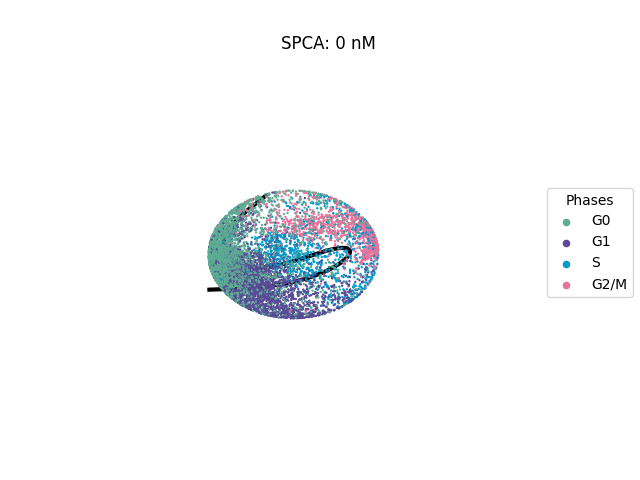

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/2720004863.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


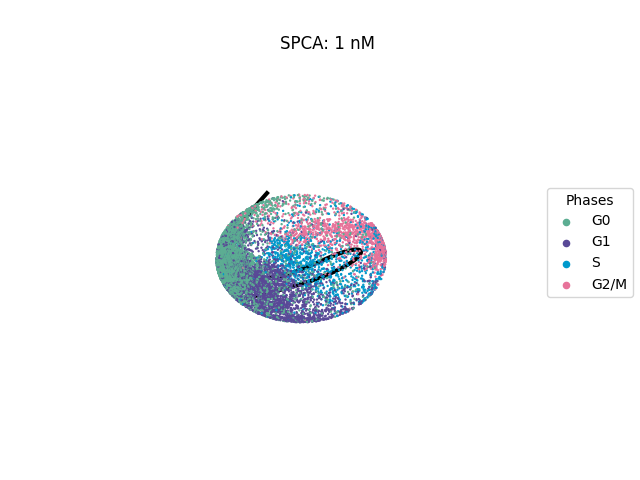

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/2720004863.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


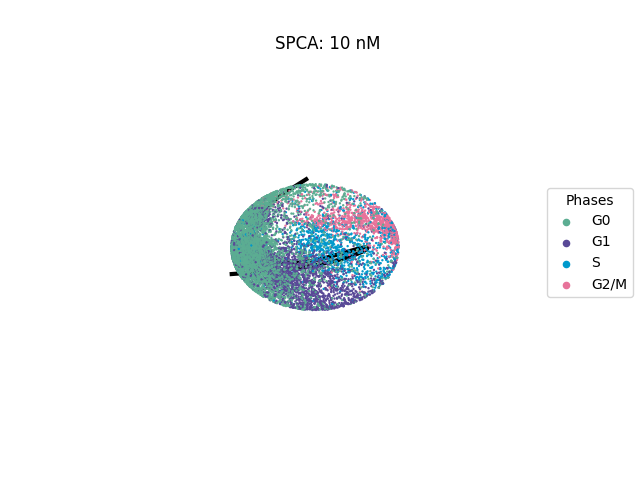

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/2720004863.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


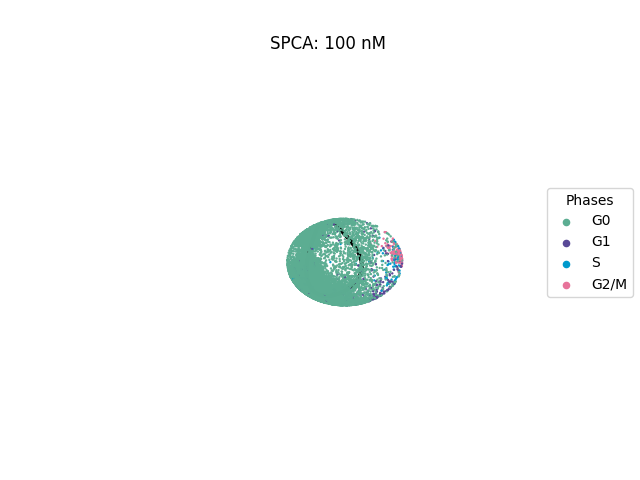

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/2720004863.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


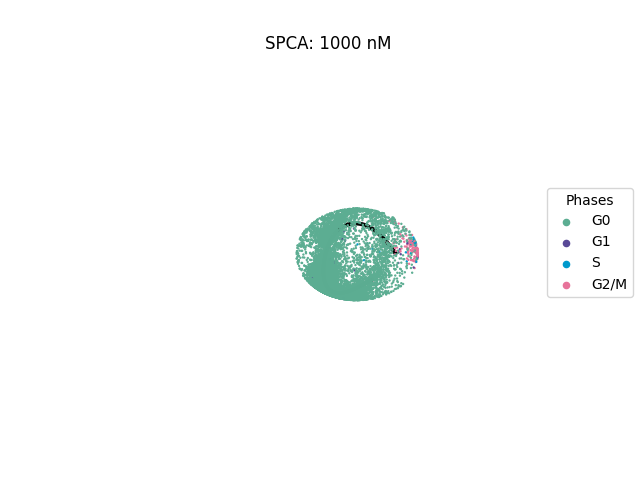

In [11]:
%matplotlib widget

for i in range(1, len(trt_conditions)):
        fig = plt.figure()
        ax=fig.add_subplot(111,projection='3d')

        phase_colors = vars()[f'x{trt_conditions[i]}_phase_colors']
        spca = vars()[f'x_spca_{trt_conditions[i]}']
        curve = vars()[f'spca_curve_{trt_conditions[i]}']

        ax.scatter3D(spca['SPCA_1'], 
                spca['SPCA_2'],
                spca['SPCA_3'],
                alpha=1, 
                c=phase_colors, 
                s=0.5)

        ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')

        # Set axis labels
        ax.set_xlabel('SPCA 1')
        ax.set_ylabel('SPCA 2')
        ax.set_zlabel('SPCA 3')

        plt.xlim(-6, 6)
        plt.ylim(-6, 6)
        ax.set_zlim(-6, 6)

        plt.grid(False)
        plt.axis('off')

        # Add a legend
        plt.scatter([], [], c='#5CAD92', s=20, label="G0")
        plt.scatter([], [], c='#594997', s=20, label="G1")
        plt.scatter([], [], c='#0099CC', s=20, label="S")
        plt.scatter([], [], c='#E7739A', s=20, label="G2/M")
        plt.legend(bbox_to_anchor=(1.4, 0.5),
                loc="right",
                borderaxespad=2.,
                scatterpoints=1, 
                title="Phases")

        ax.view_init(5,120)

        ax.set_title(f'SPCA: {trt_conditions[i]} nM')

        # Show the plot
        plt.show()

        plt.savefig(f"figures/spca_{trt_conditions[i]}.pdf", format="pdf", bbox_inches="tight")

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/1834633054.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


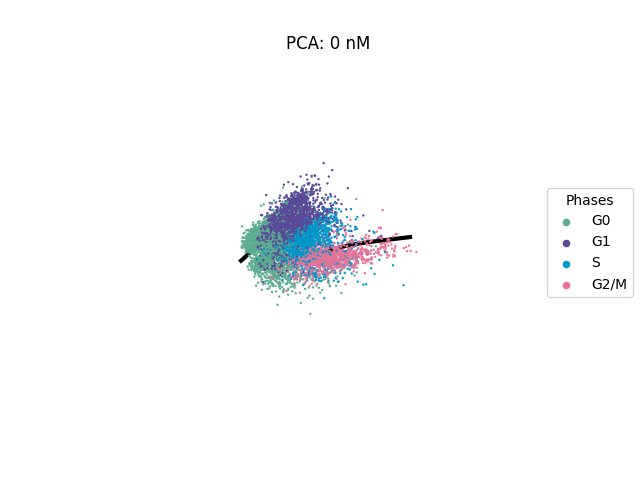

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/1834633054.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


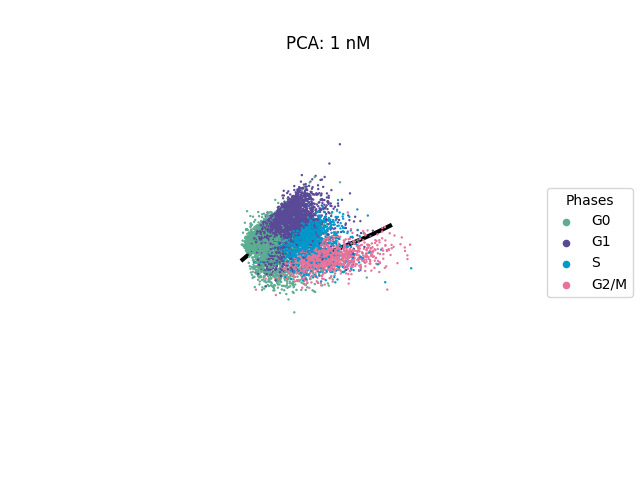

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/1834633054.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


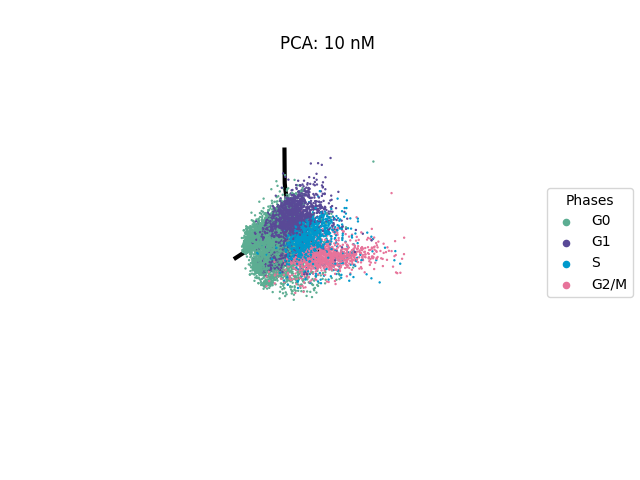

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/1834633054.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


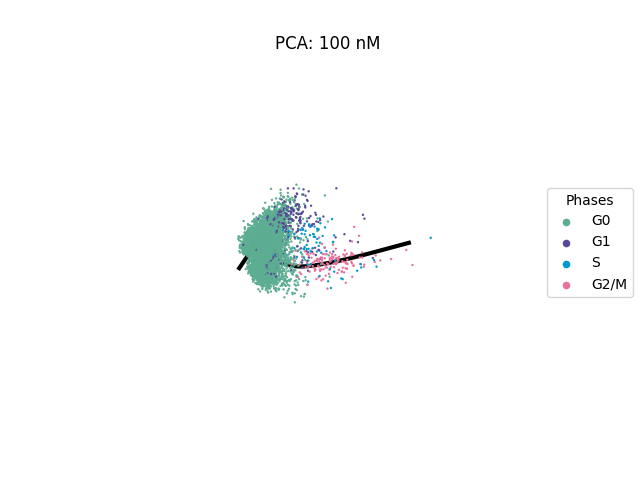

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/1834633054.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


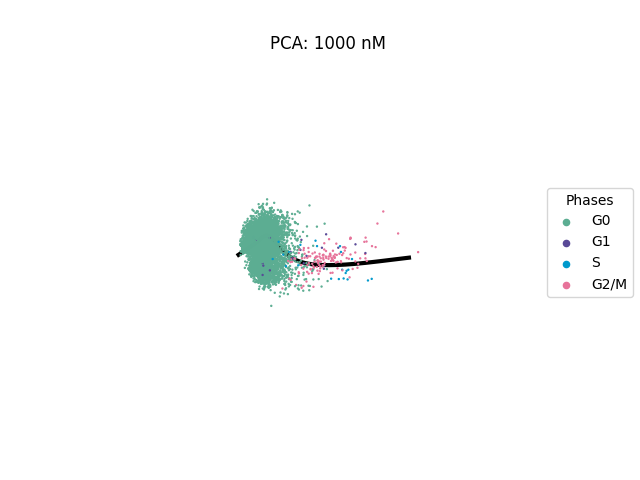

In [12]:
%matplotlib widget

for i in range(1,len(trt_conditions)):
        fig = plt.figure()
        ax=fig.add_subplot(111,projection='3d')

        phase_colors = vars()[f'x{trt_conditions[i]}_phase_colors']
        pca = vars()[f'x_pca_{trt_conditions[i]}']
        curve = vars()[f'pca_curve_{trt_conditions[i]}']

        ax.scatter3D(pca['PCA_1'], 
                pca['PCA_2'],
                pca['PCA_3'],
                alpha=1, 
                c=phase_colors, 
                s=0.5)

        ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')

        # Set axis labels
        ax.set_xlabel('PCA 1')
        ax.set_ylabel('PCA 2')
        ax.set_zlabel('PCA 3')

        plt.xlim(-5, 20)
        plt.ylim(-10, 10)
        ax.set_zlim(-8, 8)

        ax.view_init(5,240)

        plt.grid(False)
        plt.axis('off')

        # Add a legend
        plt.scatter([], [], c='#5CAD92', s=20, label="G0")
        plt.scatter([], [], c='#594997', s=20, label="G1")
        plt.scatter([], [], c='#0099CC', s=20, label="S")
        plt.scatter([], [], c='#E7739A', s=20, label="G2/M")
        plt.legend(bbox_to_anchor=(1.4, 0.5),
                loc="right",
                borderaxespad=2.,
                scatterpoints=1, 
                title="Phases")

        ax.set_title(f'PCA: {trt_conditions[i]} nM')

        # Show the plot
        plt.show()

        plt.savefig(f"figures/pca_{trt_conditions[i]}.pdf", format="pdf", bbox_inches="tight")

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/100277591.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


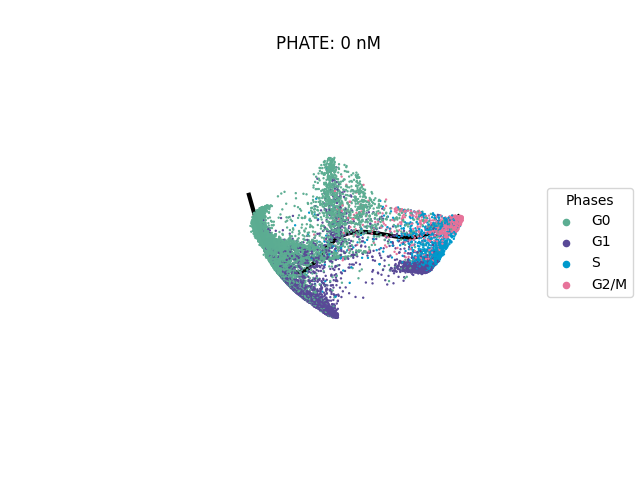

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/100277591.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


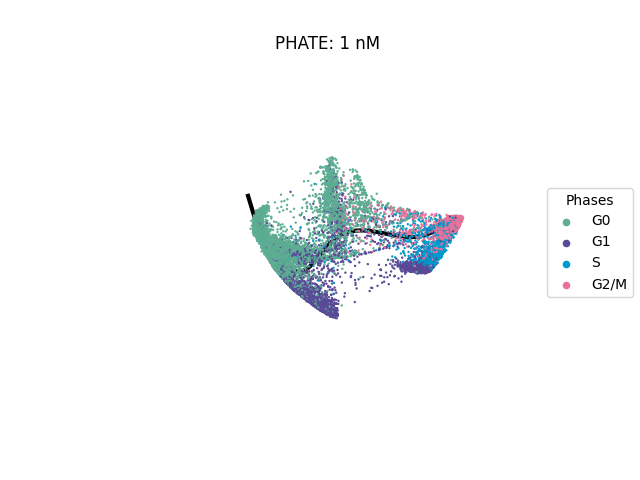

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/100277591.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


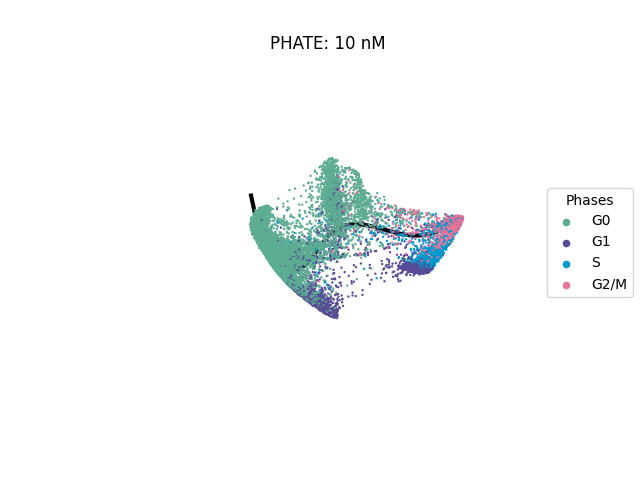

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/100277591.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


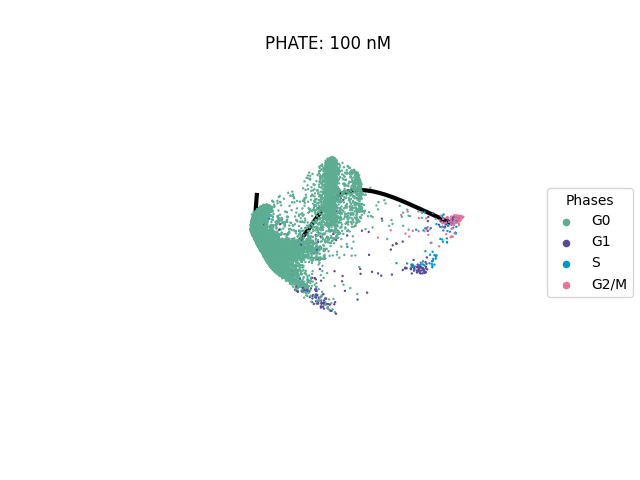

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/100277591.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')


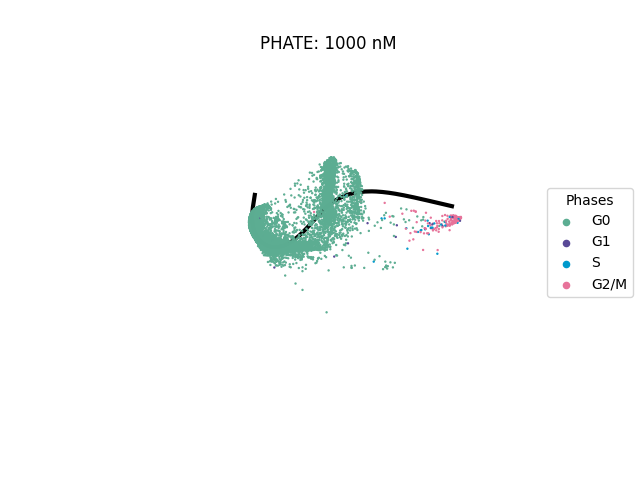

In [14]:
%matplotlib widget

for i in range(1,len(trt_conditions)):
        fig = plt.figure()
        ax=fig.add_subplot(111,projection='3d')

        phase_colors = vars()[f'x{trt_conditions[i]}_phase_colors']
        phate = vars()[f'x_phate_{trt_conditions[i]}']
        curve = vars()[f'phate_curve_{trt_conditions[i]}']

        ax.scatter3D(phate['PHATE_1'], 
                phate['PHATE_2'],
                phate['PHATE_3'],
                alpha=1, 
                c=phase_colors, 
                s=0.5)

        ax.plot(curve['curve_x'], curve['curve_y'], curve['curve_z'], '-r', linewidth = 3, c='black')

        # Set axis labels
        ax.set_xlabel('PHATE 1')
        ax.set_ylabel('PHATE 2')
        ax.set_zlabel('PHATE 3')

        plt.xlim(-0.03, 0.04)
        plt.ylim(-0.01, 0.02)
        ax.set_zlim(-0.02, 0.02)

        ax.view_init(5,280)

        plt.grid(False)
        plt.axis('off')

        # Add a legend
        plt.scatter([], [], c='#5CAD92', s=20, label="G0")
        plt.scatter([], [], c='#594997', s=20, label="G1")
        plt.scatter([], [], c='#0099CC', s=20, label="S")
        plt.scatter([], [], c='#E7739A', s=20, label="G2/M")
        plt.legend(bbox_to_anchor=(1.4, 0.5),
                loc="right",
                borderaxespad=2.,
                scatterpoints=1, 
                title="Phases")

        ax.set_title(f'PHATE: {trt_conditions[i]} nM')

        # Show the plot
        plt.show()

        plt.savefig(f"figures/phate_{trt_conditions[i]}.pdf", format="pdf", bbox_inches="tight")

### Projections: All Treatment Conditions

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

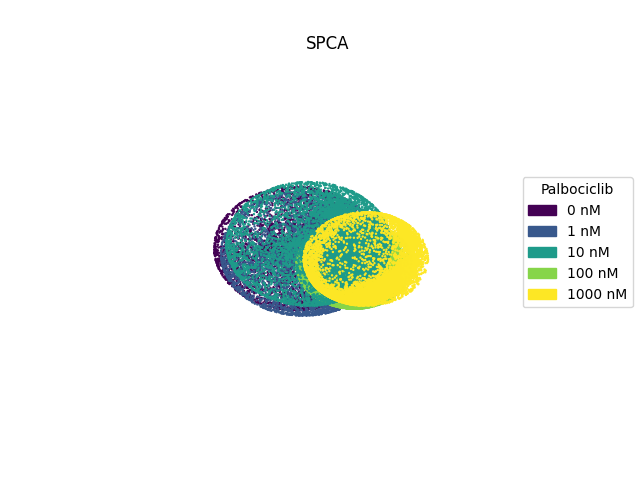

In [15]:
%matplotlib widget

# Create a 3D scatterplot
fig = plt.figure()
ax=fig.add_subplot(111,projection='3d')

for i in range(1, len(trt_conditions)): 
    ax.scatter3D(vars()[f'x_spca_{trt_conditions[i]}']['SPCA_1'],
                 vars()[f'x_spca_{trt_conditions[i]}']['SPCA_2'],
                 vars()[f'x_spca_{trt_conditions[i]}']['SPCA_3'],
                alpha=1, 
                c=trt_colors[i-1],
                s=0.5)
    
plt.xlim(-6, 6)
plt.ylim(-6, 6)
ax.set_zlim(-6, 6)

plt.axis('off')

# Add a legend
color_0 = mpatches.Patch(color=trt_colors[0], label='0 nM')
color_1 = mpatches.Patch(color=trt_colors[1], label='1 nM')
color_10 = mpatches.Patch(color=trt_colors[2], label='10 nM')
color_100 = mpatches.Patch(color=trt_colors[3], label='100 nM')
color_1000 = mpatches.Patch(color=trt_colors[4], label='1000 nM')
ax.legend(bbox_to_anchor=(1.4, 0.5),
            loc="right",
            borderaxespad=2.,
            title="Palbociclib",
            handles=[color_0, color_1, color_10, color_100, color_1000])

ax.view_init(5,200)

ax.set_title('SPCA')

# Set axis labels
ax.set_xlabel('SPCA 1')
ax.set_ylabel('SPCA 2')
ax.set_zlabel('SPCA 3')

# plt.grid(False)
# plt.axis('off')

# Show the plot
plt.show()

plt.savefig("figures/spca_all_trt.pdf", format="pdf", bbox_inches="tight")

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

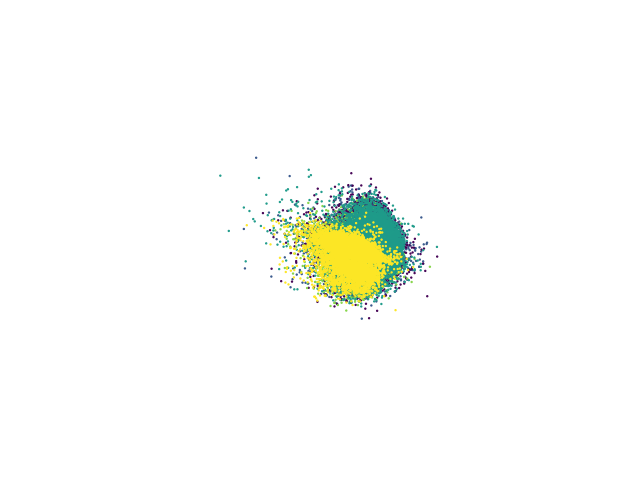

In [16]:
%matplotlib widget

# Create a 3D scatterplot
fig = plt.figure()
ax=fig.add_subplot(111,projection='3d')

for i in range(1, 6): 
    ax.scatter3D(vars()[f'x_pca_{trt_conditions[i]}']['PCA_1'],
                 vars()[f'x_pca_{trt_conditions[i]}']['PCA_2'],
                 vars()[f'x_pca_{trt_conditions[i]}']['PCA_3'],
                alpha=1, 
                c=trt_colors[i-1],
                s=0.5)

plt.axis('off')

# Set axis labels
ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')

ax.view_init(5,170)

# plt.grid(False)
# plt.axis('off')

# Show the plot
plt.show()

plt.savefig("figures/pca_all_trt.pdf", format="pdf", bbox_inches="tight")

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

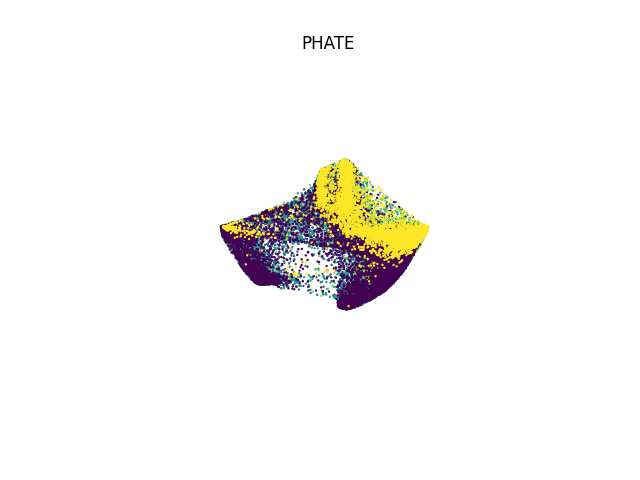

In [17]:
fig = plt.figure()
ax=fig.add_subplot(111, projection="3d")

for i in range(1, len(trt_conditions)): 
    ax.scatter3D(vars()[f'x_phate_{trt_conditions[i]}']['PHATE_1'],
                 vars()[f'x_phate_{trt_conditions[i]}']['PHATE_2'],
                 vars()[f'x_phate_{trt_conditions[i]}']['PHATE_3'],
                alpha=1, 
                c=trt_colors[i-1],
                s=0.5)

# Set axis labels
ax.set_xlabel('PHATE 1')
ax.set_ylabel('PHATE 2')
ax.set_zlabel('PHATE 3')

# plt.xticks(np.arange(-0.02, 0.06, 0.02))
# plt.yticks(np.arange(-0.03, 0.05, 0.02))
# ax.set_zticks(np.arange(-0.02, 0.03, 0.02))

ax.set_title('PHATE')

ax.view_init(5,100)

# plt.grid(False)
plt.axis('off')

# Show the plot
plt.show()

plt.savefig("figures/phate_all_trt.pdf", format="pdf", bbox_inches="tight")

### Feature Exp vs Pseudotime

In [18]:
x0_sorted = x0
x0_sorted['phase_colors'] = x0_phase_colors
x1_sorted = x1
x1_sorted['phase_colors'] = x1_phase_colors
x10_sorted = x10
x10_sorted['phase_colors'] = x10_phase_colors
x100_sorted = x100
x100_sorted['phase_colors'] = x100_phase_colors
x1000_sorted = x1000
x1000_sorted['phase_colors'] = x1000_phase_colors

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/540281031.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x0_sorted['phase_colors'] = x0_phase_colors
/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/540281031.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x1_sorted['phase_colors'] = x1_phase_colors
/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/540281031.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

In [19]:
x0_sorted_spca = x0.sort_values('pseudotime_spca')
x1_sorted_spca = x1.sort_values('pseudotime_spca')
x10_sorted_spca = x10.sort_values('pseudotime_spca')
x100_sorted_spca = x100.sort_values('pseudotime_spca')
x1000_sorted_spca = x1000.sort_values('pseudotime_spca')

x0_sorted_pca = x0.sort_values('pseudotime_pca')
x1_sorted_pca = x1.sort_values('pseudotime_pca')
x10_sorted_pca = x10.sort_values('pseudotime_pca')
x100_sorted_pca = x100.sort_values('pseudotime_pca')
x1000_sorted_pca = x1000.sort_values('pseudotime_pca')

x0_sorted_phate = x0.sort_values('pseudotime_phate')
x1_sorted_phate = x1.sort_values('pseudotime_phate')
x10_sorted_phate = x10.sort_values('pseudotime_phate')
x100_sorted_phate = x100.sort_values('pseudotime_phate')
x1000_sorted_phate = x1000.sort_values('pseudotime_phate')

In [20]:
# scale pseudotimes 
x0_sorted_spca['pseudotime_scaled'] = x0_sorted_spca['pseudotime_spca']/max(x0_sorted_spca['pseudotime_spca'])
x1_sorted_spca['pseudotime_scaled'] = x1_sorted_spca['pseudotime_spca']/max(x1_sorted_spca['pseudotime_spca'])
x10_sorted_spca['pseudotime_scaled'] = x10_sorted_spca['pseudotime_spca']/max(x10_sorted_spca['pseudotime_spca'])
x100_sorted_spca['pseudotime_scaled'] = x100_sorted_spca['pseudotime_spca']/max(x100_sorted_spca['pseudotime_spca'])
x1000_sorted_spca['pseudotime_scaled'] = x1000_sorted_spca['pseudotime_spca']/max(x1000_sorted_spca['pseudotime_spca'])

x0_sorted_pca['pseudotime_scaled'] = x0_sorted_pca['pseudotime_pca']/max(x0_sorted_pca['pseudotime_pca'])
x1_sorted_pca['pseudotime_scaled'] = x1_sorted_pca['pseudotime_pca']/max(x1_sorted_pca['pseudotime_pca'])
x10_sorted_pca['pseudotime_scaled'] = x10_sorted_pca['pseudotime_pca']/max(x10_sorted_pca['pseudotime_pca'])
x100_sorted_pca['pseudotime_scaled'] = x100_sorted_pca['pseudotime_pca']/max(x100_sorted_pca['pseudotime_pca'])
x1000_sorted_pca['pseudotime_scaled'] = x1000_sorted_pca['pseudotime_pca']/max(x1000_sorted_pca['pseudotime_pca'])

x0_sorted_phate['pseudotime_scaled'] = x0_sorted_phate['pseudotime_phate']/max(x0_sorted_phate['pseudotime_phate'])
x1_sorted_phate['pseudotime_scaled'] = x1_sorted_phate['pseudotime_phate']/max(x1_sorted_phate['pseudotime_phate'])
x10_sorted_phate['pseudotime_scaled'] = x10_sorted_phate['pseudotime_phate']/max(x10_sorted_phate['pseudotime_phate'])
x100_sorted_phate['pseudotime_scaled'] = x100_sorted_phate['pseudotime_phate']/max(x100_sorted_phate['pseudotime_phate'])
x1000_sorted_phate['pseudotime_scaled'] = x1000_sorted_phate['pseudotime_phate']/max(x1000_sorted_phate['pseudotime_phate'])

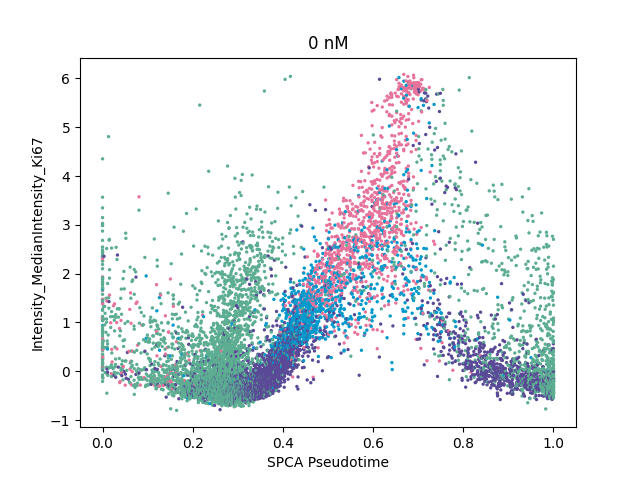

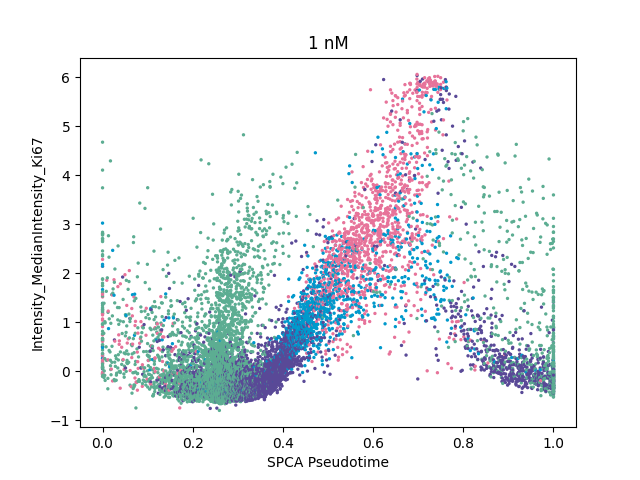

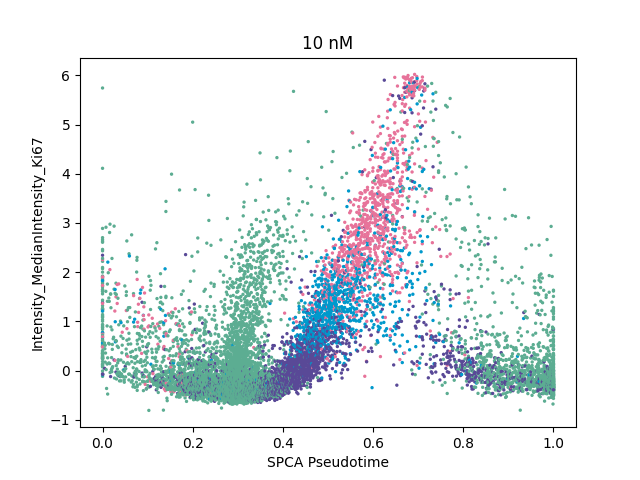

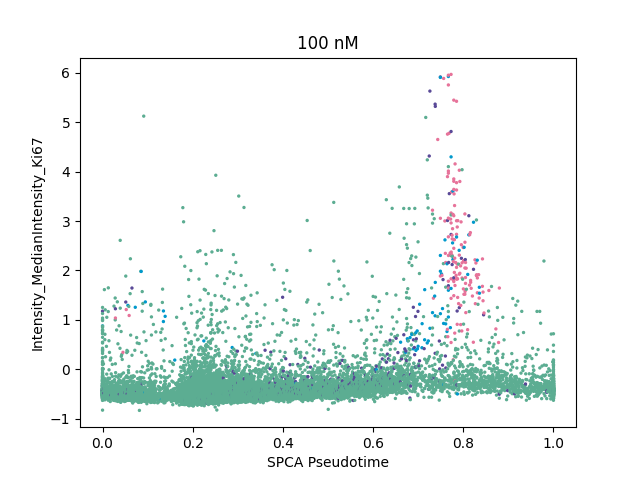

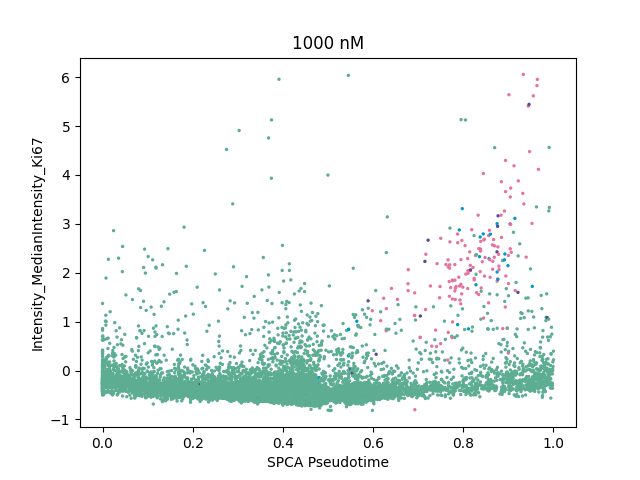

In [22]:
feature = 'Intensity_MedianIntensity_Ki67'
for i in range(1, len(trt_conditions)):
    fig = plt.figure()
    ax=fig.add_subplot(111)
    sling_colors = vars()[f'x{trt_conditions[i]}_sorted_spca']['phase_colors']
    ax.scatter(vars()[f'x{trt_conditions[i]}_sorted_spca']['pseudotime_scaled'], vars()[f'x{trt_conditions[i]}_sorted_spca'][feature], c=sling_colors, s=2)
    plt.xlabel('SPCA Pseudotime')
    plt.ylabel(feature)
    plt.title(f'{trt_conditions[i]} nM')
    plt.show()

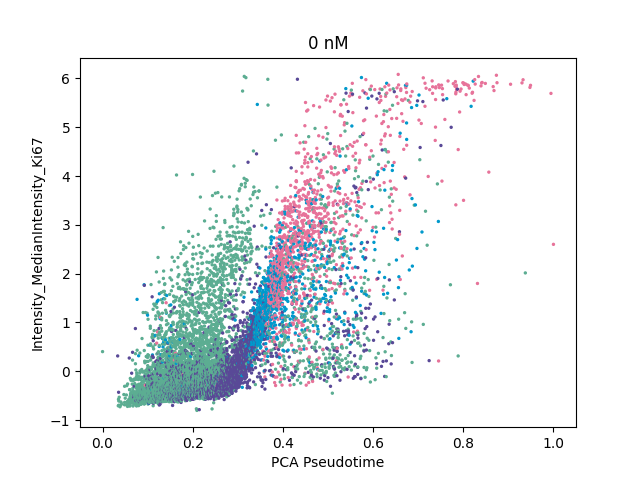

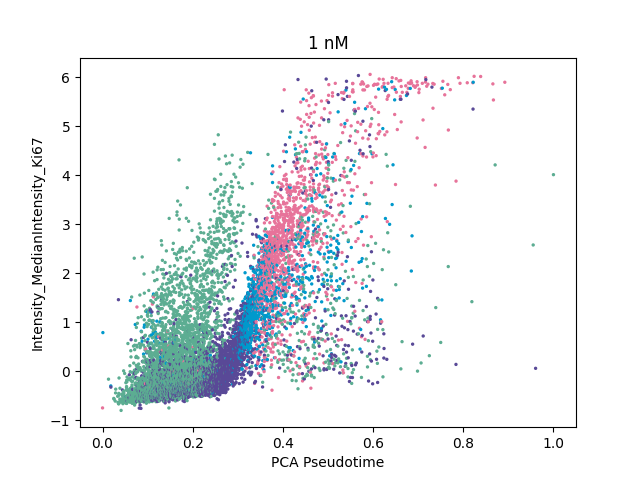

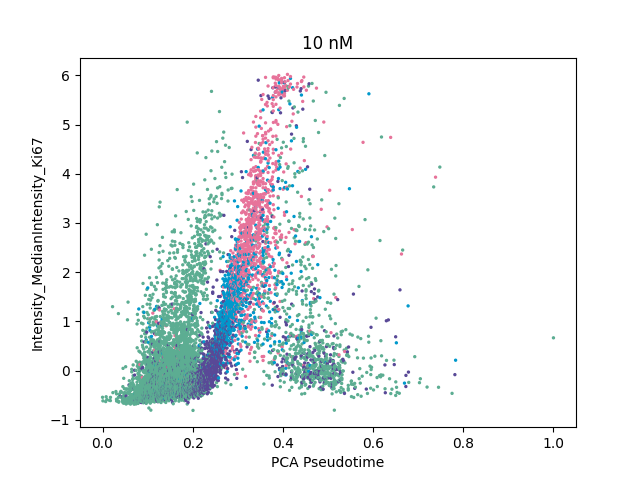

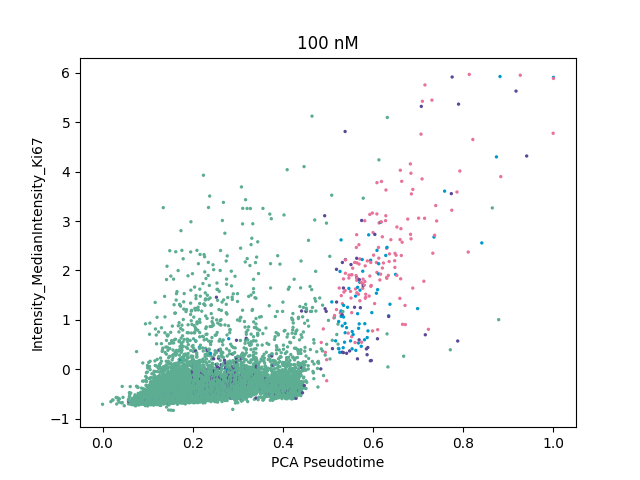

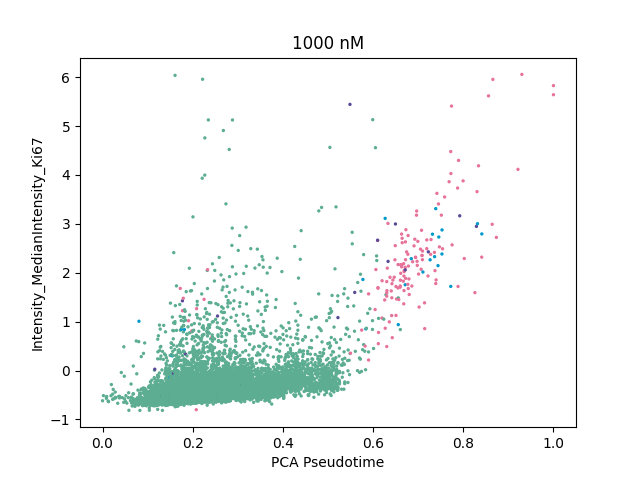

In [23]:
feature = 'Intensity_MedianIntensity_Ki67'
for i in range(1, len(trt_conditions)):
    fig = plt.figure()
    ax=fig.add_subplot(111)
    sling_colors = vars()[f'x{trt_conditions[i]}_sorted_pca']['phase_colors']
    ax.scatter(vars()[f'x{trt_conditions[i]}_sorted_pca']['pseudotime_scaled'], vars()[f'x{trt_conditions[i]}_sorted_pca'][feature], c=sling_colors, s=2)
    plt.xlabel('PCA Pseudotime')
    plt.ylabel(feature)
    plt.title(f'{trt_conditions[i]} nM')
    plt.show()

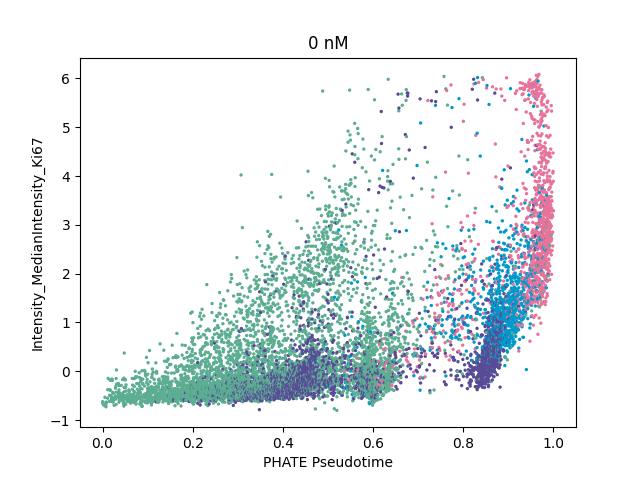

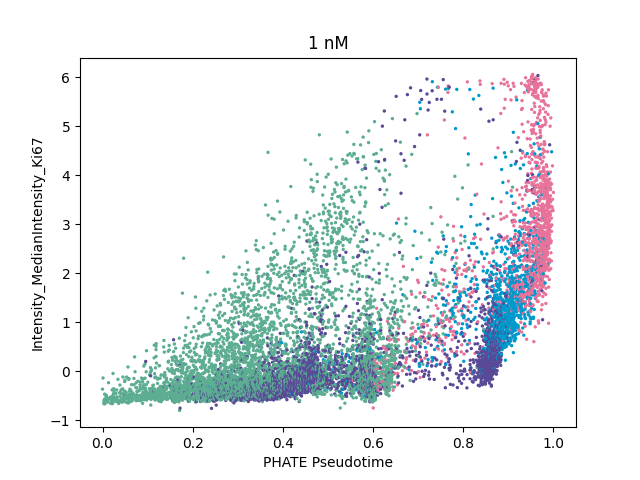

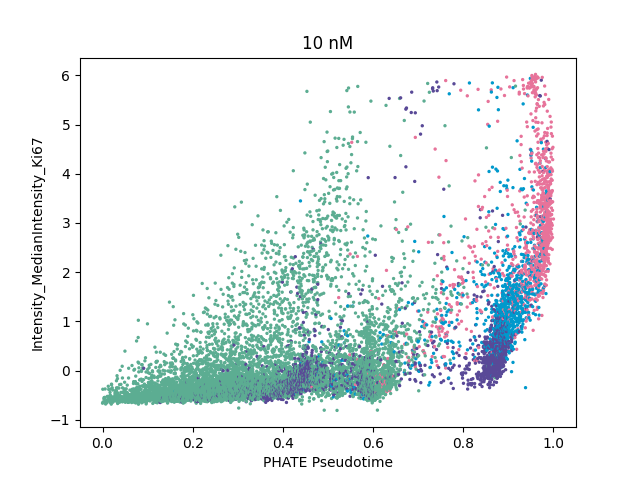

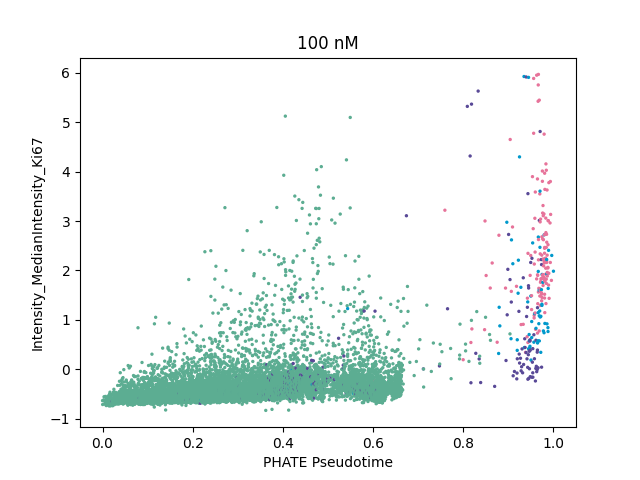

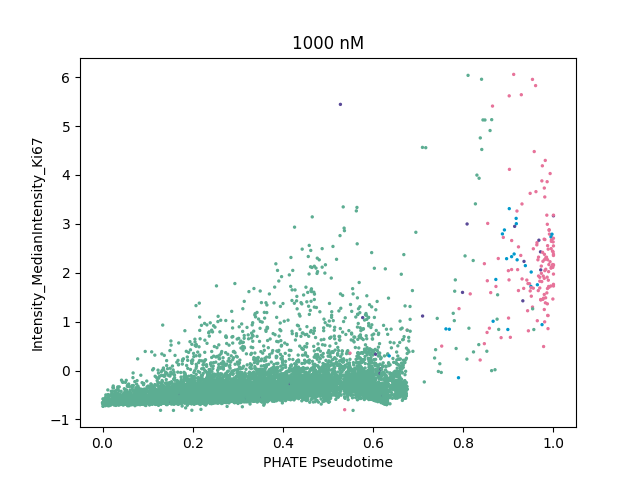

In [24]:
feature = 'Intensity_MedianIntensity_Ki67'
for i in range(1, len(trt_conditions)):
    fig = plt.figure()
    ax=fig.add_subplot(111)
    sling_colors = vars()[f'x{trt_conditions[i]}_sorted_phate']['phase_colors']
    ax.scatter(vars()[f'x{trt_conditions[i]}_sorted_phate']['pseudotime_scaled'], vars()[f'x{trt_conditions[i]}_sorted_phate'][feature], c=sling_colors, s=2)
    plt.xlabel('PHATE Pseudotime')
    plt.ylabel(feature)
    plt.title(f'{trt_conditions[i]} nM')
    plt.show()

In [ ]:
x0_loess_spca = pd.DataFrame()
x0_loess_spca['pseudotime_scaled'] = x0_sorted_spca['pseudotime_scaled']

x0_loess_pca = pd.DataFrame()
x0_loess_pca['pseudotime_scaled'] = x0_sorted_pca['pseudotime_scaled']

x0_loess_phate = pd.DataFrame()
x0_loess_phate['pseudotime_scaled'] = x0_sorted_phate['pseudotime_scaled']

In [ ]:
xx = x0_loess_spca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x0_sorted_spca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x0_loess_spca[feature_cols[i]] = yout

In [ ]:
xx = x0_loess_pca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x0_sorted_pca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x0_loess_pca[feature_cols[i]] = yout

In [ ]:
xx = x0_loess_phate['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x0_sorted_phate[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x0_loess_phate[feature_cols[i]] = yout

In [ ]:
# x0_loess_spca.to_csv("data/spca_loess_0.csv", index = False)
# x0_loess_pca.to_csv("data/pca_loess_0.csv", index = False)
# x0_loess_phate.to_csv("data/phate_loess_0.csv", index = False)

In [25]:
# run if trend data has been calculated and written to a csv from running above 
x0_loess_spca = pd.read_csv("data/spca_loess_0.csv")
x0_loess_pca = pd.read_csv("data/pca_loess_0.csv")
x0_loess_phate = pd.read_csv("data/phate_loess_0.csv")

### Cell Cycle Trends 

In [26]:
trend_colors = {
    'cycA': '#023E8A',
    'cycB1': '#F29222', 
    'cycD1': '#E03C31',
    'cycE': '#A1C65D', 
    'E2F1': '#FAC723', 
    'DNA': '#936FAC'
}

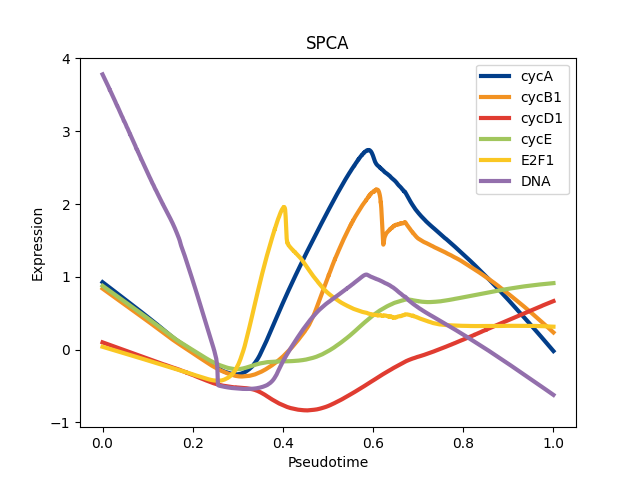

In [27]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.plot(x0_loess_spca['pseudotime_scaled'], x0_loess_spca['Intensity_MedianIntensity_cycA'], label='cycA', c=trend_colors['cycA'], linewidth='3')
ax.plot(x0_loess_spca['pseudotime_scaled'], x0_loess_spca['Intensity_MedianIntensity_cycB1'], label='cycB1', c=trend_colors['cycB1'], linewidth='3')
ax.plot(x0_loess_spca['pseudotime_scaled'], x0_loess_spca['Intensity_MedianIntensity_cycD1'], label='cycD1', c=trend_colors['cycD1'], linewidth='3')
ax.plot(x0_loess_spca['pseudotime_scaled'], x0_loess_spca['Intensity_MedianIntensity_cycE'], label='cycE', c=trend_colors['cycE'], linewidth='3')
ax.plot(x0_loess_spca['pseudotime_scaled'], x0_loess_spca['Intensity_MedianIntensity_E2F1'], label='E2F1', c=trend_colors['E2F1'], linewidth='3')
ax.plot(x0_loess_spca['pseudotime_scaled'], x0_loess_spca['Intensity_IntegratedIntensity_DNA'], label='DNA', c=trend_colors['DNA'], linewidth='3')
plt.legend()
ax.set_title('SPCA')
ax.set_xlabel('Pseudotime')
ax.set_ylabel('Expression')
plt.savefig(f"figures/feature_ti/trends_spca.pdf", format="pdf", bbox_inches="tight")


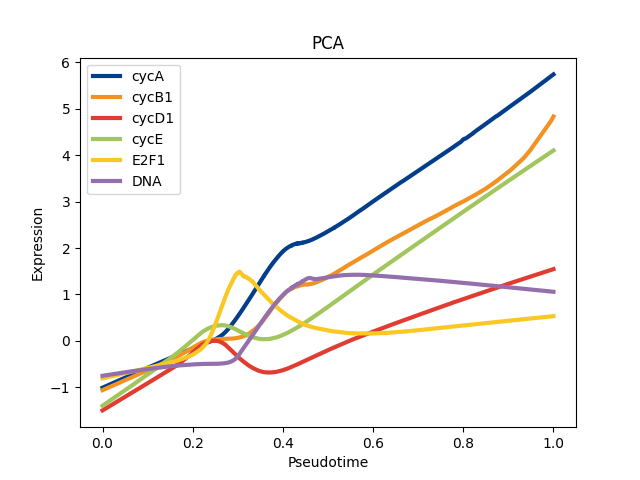

In [28]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.plot(x0_loess_pca['pseudotime_scaled'], x0_loess_pca['Intensity_MedianIntensity_cycA'], label='cycA', c=trend_colors['cycA'], linewidth='3')
ax.plot(x0_loess_pca['pseudotime_scaled'], x0_loess_pca['Intensity_MedianIntensity_cycB1'], label='cycB1', c=trend_colors['cycB1'], linewidth='3')
ax.plot(x0_loess_pca['pseudotime_scaled'], x0_loess_pca['Intensity_MedianIntensity_cycD1'], label='cycD1', c=trend_colors['cycD1'], linewidth='3')
ax.plot(x0_loess_pca['pseudotime_scaled'], x0_loess_pca['Intensity_MedianIntensity_cycE'], label='cycE', c=trend_colors['cycE'], linewidth='3')
ax.plot(x0_loess_pca['pseudotime_scaled'], x0_loess_pca['Intensity_MedianIntensity_E2F1'], label='E2F1', c=trend_colors['E2F1'], linewidth='3')
ax.plot(x0_loess_pca['pseudotime_scaled'], x0_loess_pca['Intensity_IntegratedIntensity_DNA'], label='DNA', c=trend_colors['DNA'], linewidth='3')
plt.legend()
ax.set_title('PCA')
ax.set_xlabel('Pseudotime')
ax.set_ylabel('Expression')
plt.savefig(f"figures/feature_ti/trends_pca.pdf", format="pdf", bbox_inches="tight")

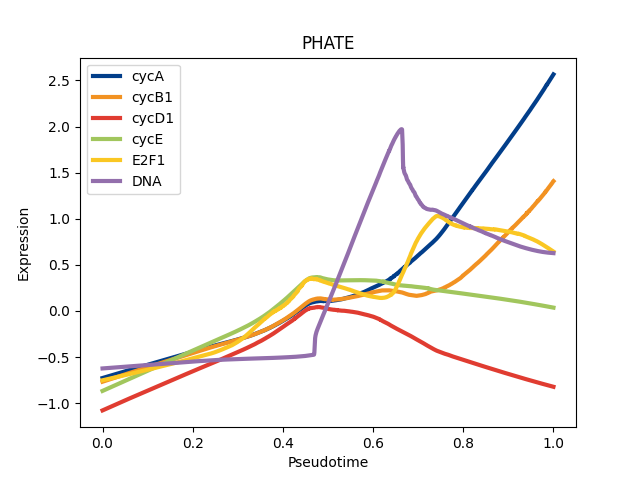

In [29]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.plot(x0_loess_phate['pseudotime_scaled'], x0_loess_phate['Intensity_MedianIntensity_cycA'], label='cycA', c=trend_colors['cycA'], linewidth='3')
ax.plot(x0_loess_phate['pseudotime_scaled'], x0_loess_phate['Intensity_MedianIntensity_cycB1'], label='cycB1', c=trend_colors['cycB1'], linewidth='3')
ax.plot(x0_loess_phate['pseudotime_scaled'], x0_loess_phate['Intensity_MedianIntensity_cycD1'], label='cycD1', c=trend_colors['cycD1'], linewidth='3')
ax.plot(x0_loess_phate['pseudotime_scaled'], x0_loess_phate['Intensity_MedianIntensity_cycE'], label='cycE', c=trend_colors['cycE'], linewidth='3')
ax.plot(x0_loess_phate['pseudotime_scaled'], x0_loess_phate['Intensity_MedianIntensity_E2F1'], label='E2F1', c=trend_colors['E2F1'], linewidth='3')
ax.plot(x0_loess_phate['pseudotime_scaled'], x0_loess_phate['Intensity_IntegratedIntensity_DNA'], label='DNA', c=trend_colors['DNA'], linewidth='3')
plt.legend()
ax.set_title('PHATE')
ax.set_xlabel('Pseudotime')
ax.set_ylabel('Expression')
plt.savefig(f"figures/feature_ti/trends_phate.pdf", format="pdf", bbox_inches="tight")

### Single Feature Exp

/var/folders/9p/p4yl9s1d43b3by_cf1ct1pl80000gn/T/ipykernel_26254/1640019232.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


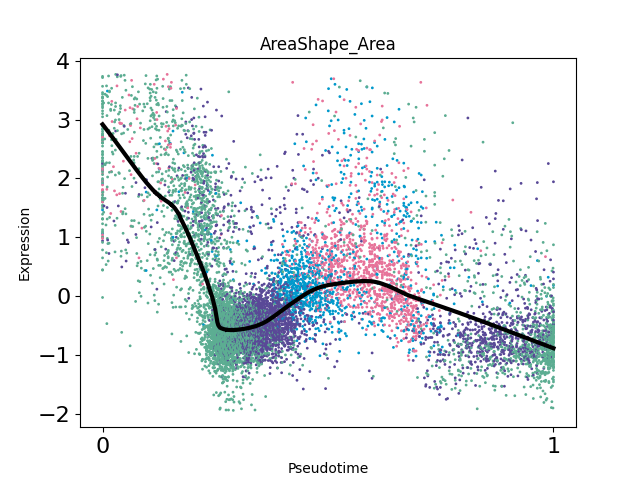

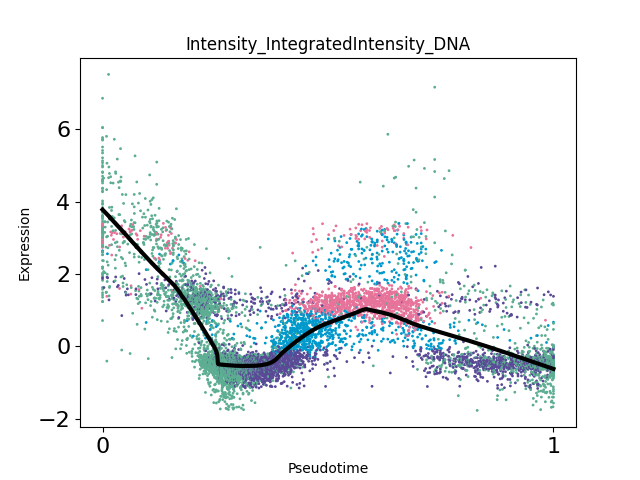

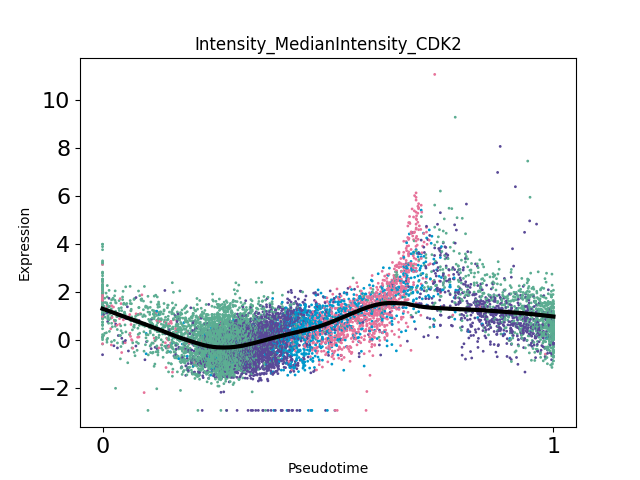

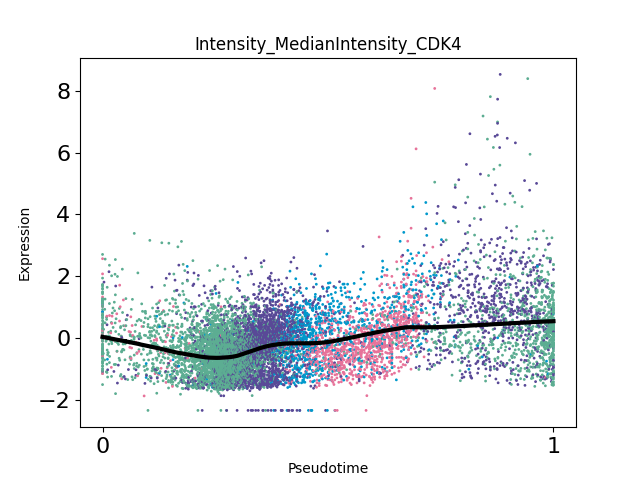

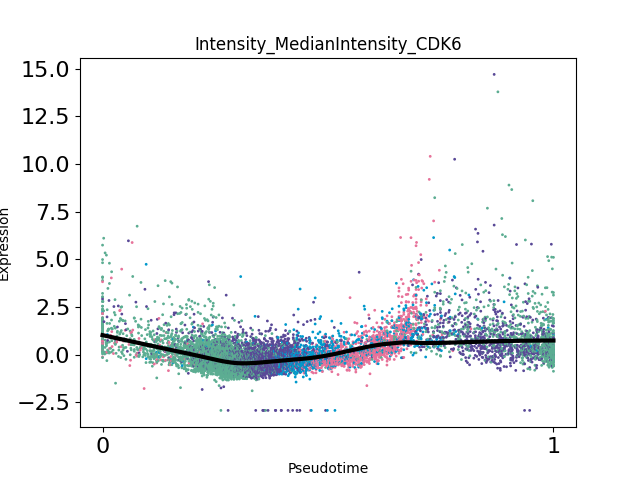

...

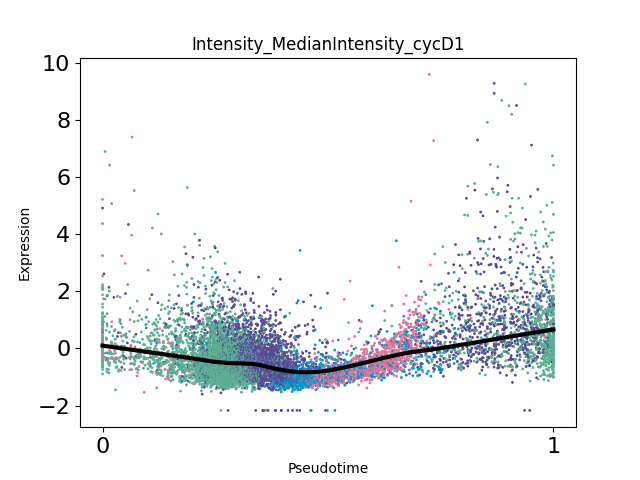

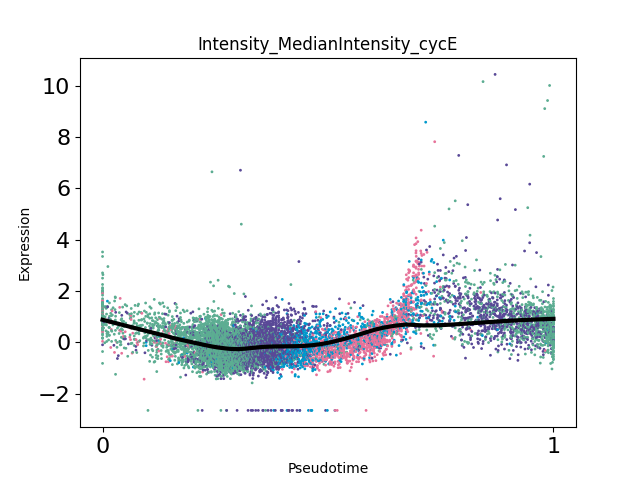

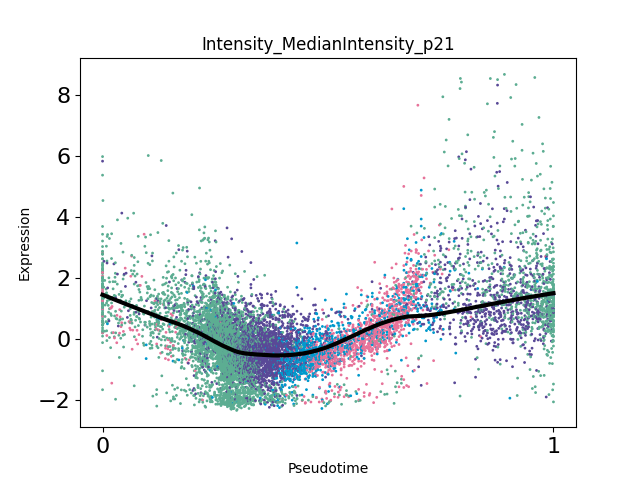

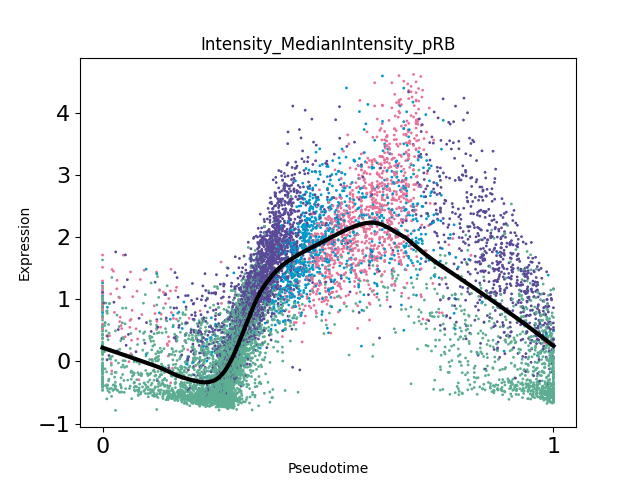

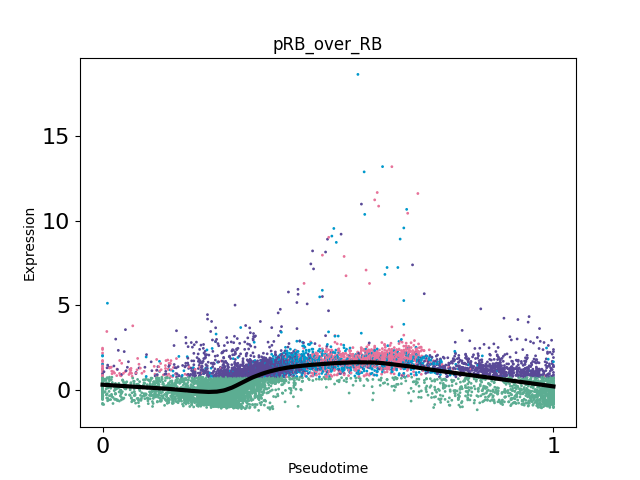

In [30]:
for feature in feature_cols:
    fig = plt.figure()
    ax=fig.add_subplot(111)
    sling_colors = x0_sorted_spca['phase_colors']
    ax.scatter(x0_sorted_spca['pseudotime_scaled'], x0_sorted_spca[feature], c=sling_colors, s=1)
    ax.plot(x0_loess_spca['pseudotime_scaled'], x0_loess_spca[feature], label='0 nM', c='black', linewidth='3')
    ax.tick_params(labelsize=16)
    ax.set_xticks([0,1])

    ax.set_title(feature)
    ax.set_xlabel('Pseudotime')
    ax.set_ylabel('Expression')

    plt.show()

    plt.savefig(f"figures/feature_ti/spca_{feature}.pdf", format="pdf", bbox_inches="tight")

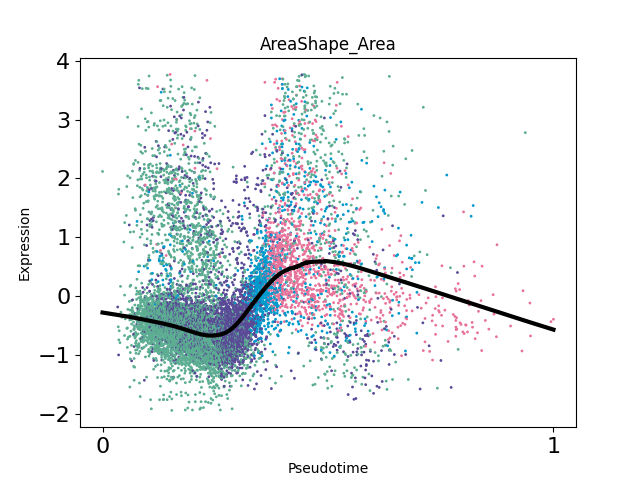

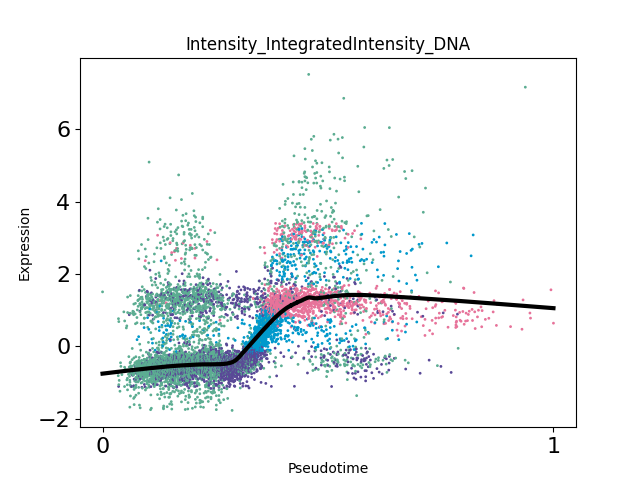

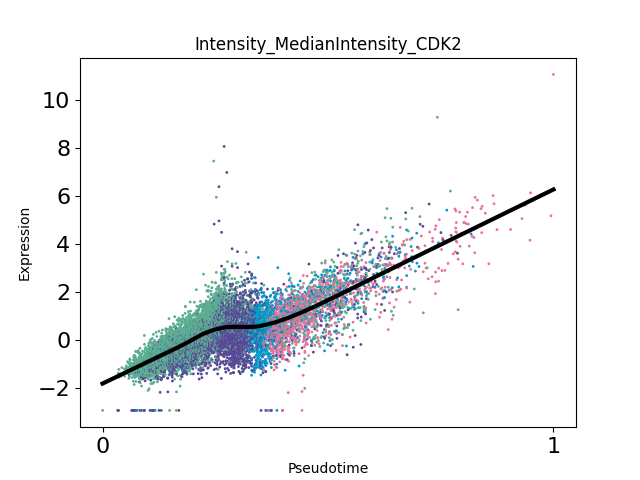

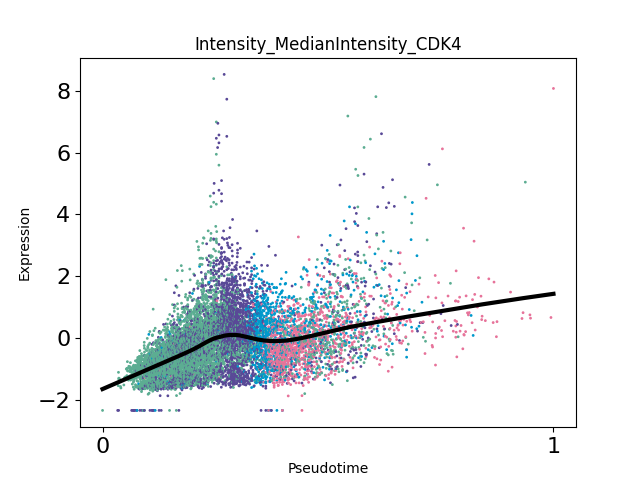

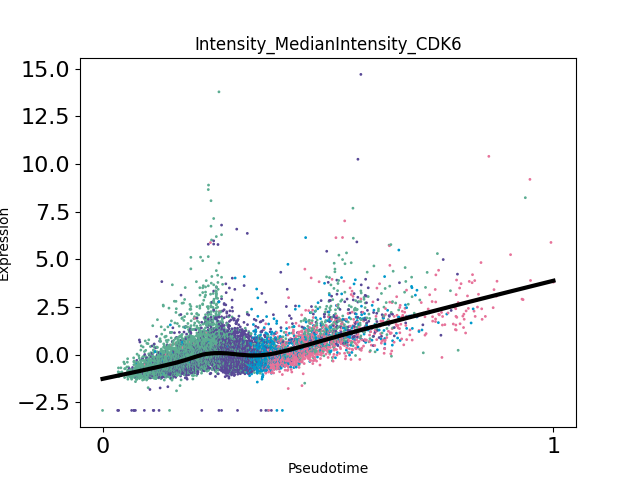

...

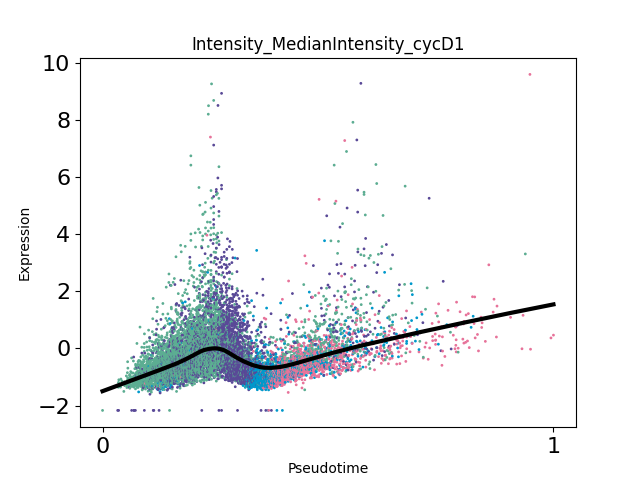

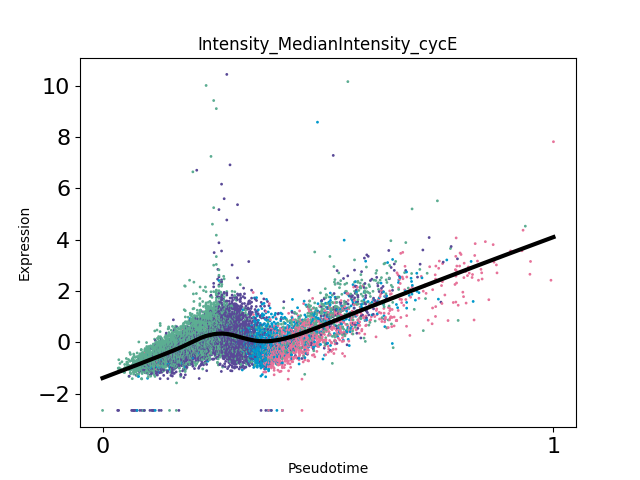

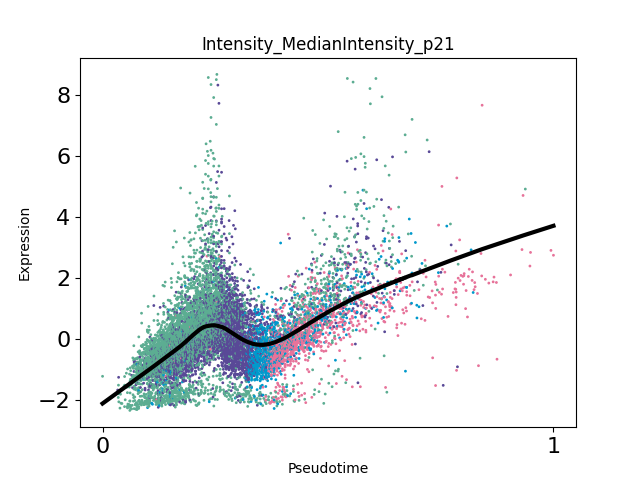

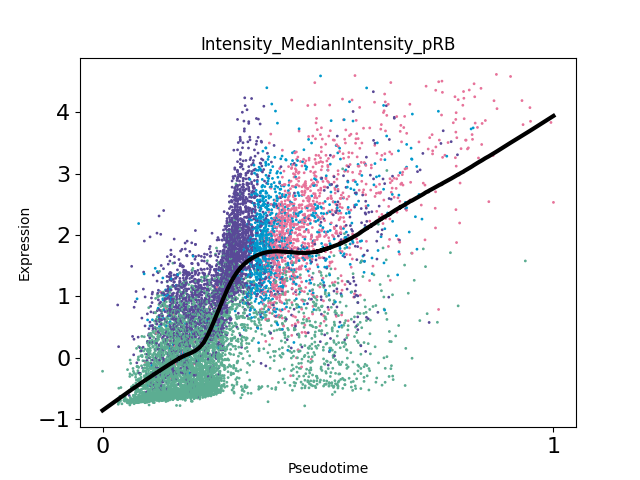

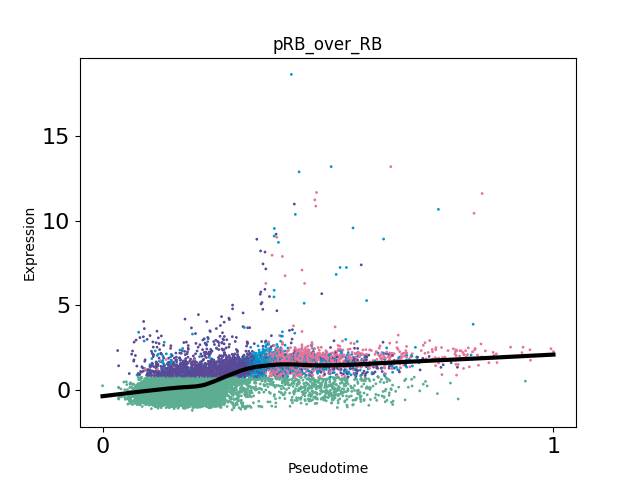

In [31]:
for feature in feature_cols:
    fig = plt.figure()
    ax=fig.add_subplot(111)
    sling_colors = x0_sorted_pca['phase_colors']
    ax.scatter(x0_sorted_pca['pseudotime_scaled'], x0_sorted_pca[feature], c=sling_colors, s=1)
    ax.plot(x0_loess_pca['pseudotime_scaled'], x0_loess_pca[feature], label='0 nM', c='black', linewidth='3')
    ax.tick_params(labelsize=16)
    ax.set_xticks([0,1])

    ax.set_title(feature)
    ax.set_xlabel('Pseudotime')
    ax.set_ylabel('Expression')

    plt.show()

    plt.savefig(f"figures/feature_ti/pca_{feature}.pdf", format="pdf", bbox_inches="tight")

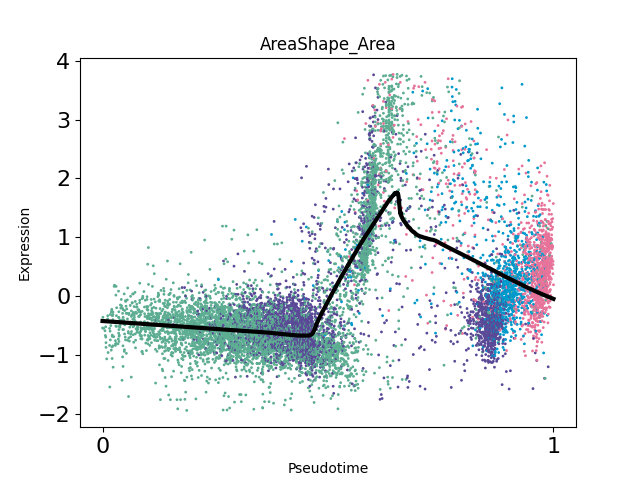

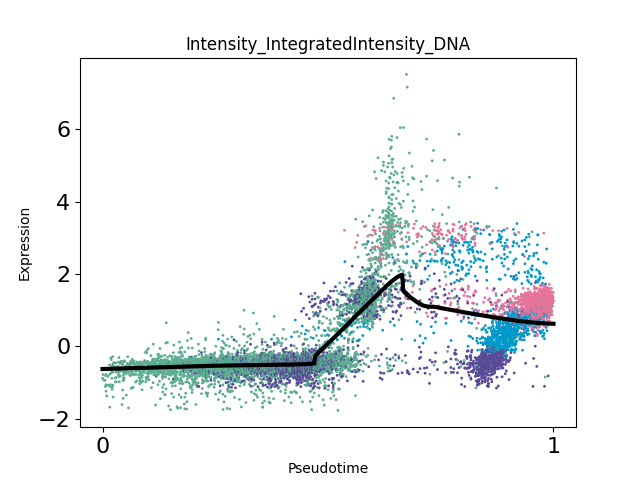

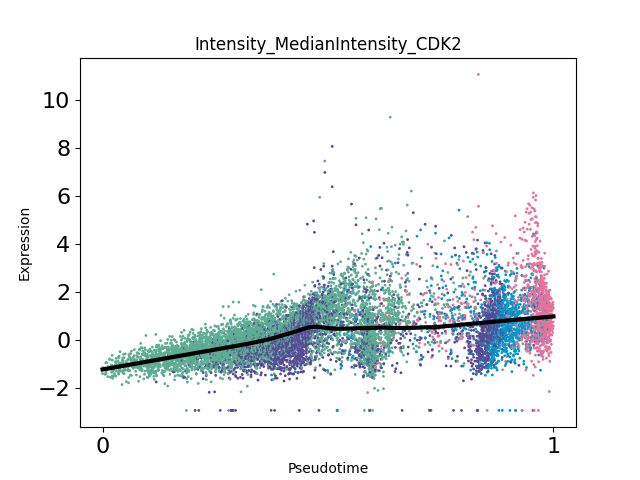

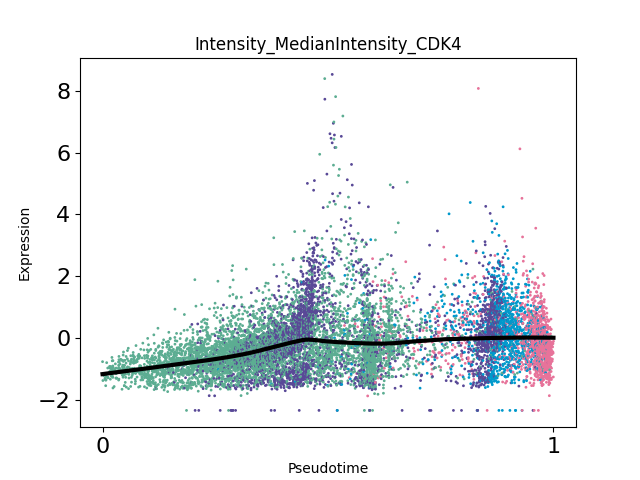

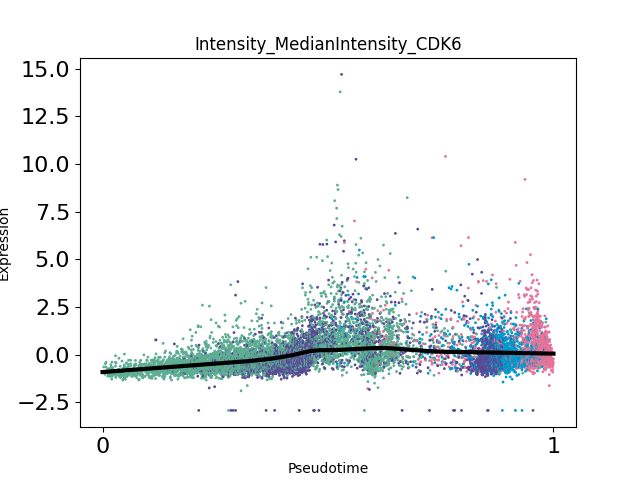

...

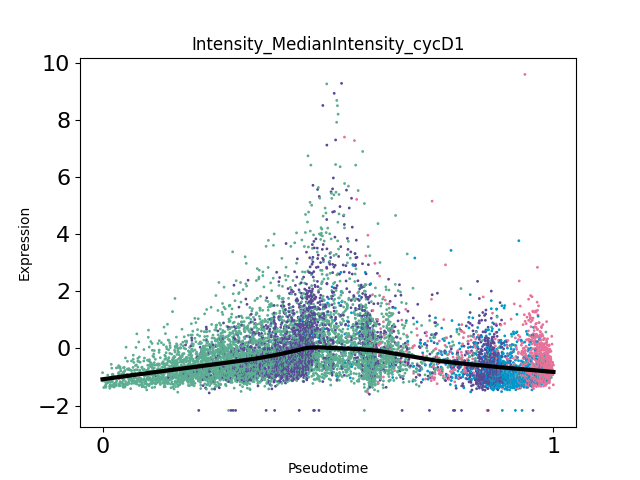

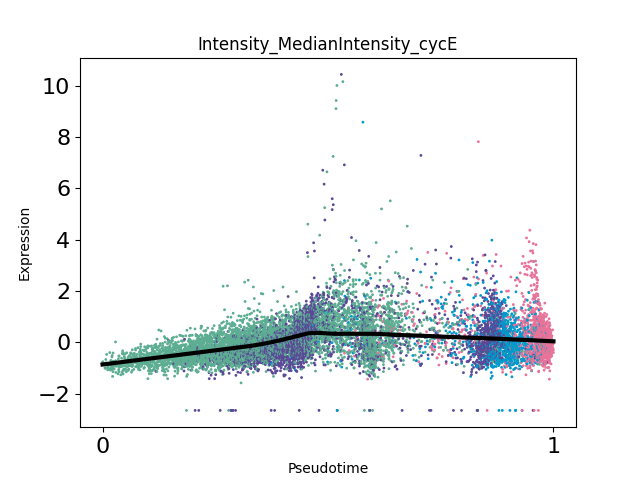

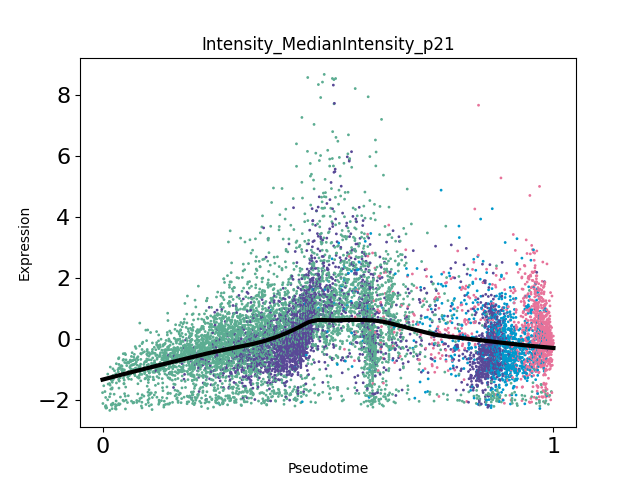

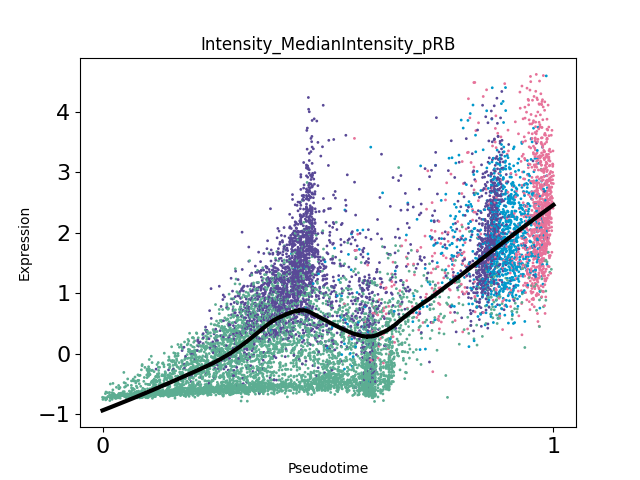

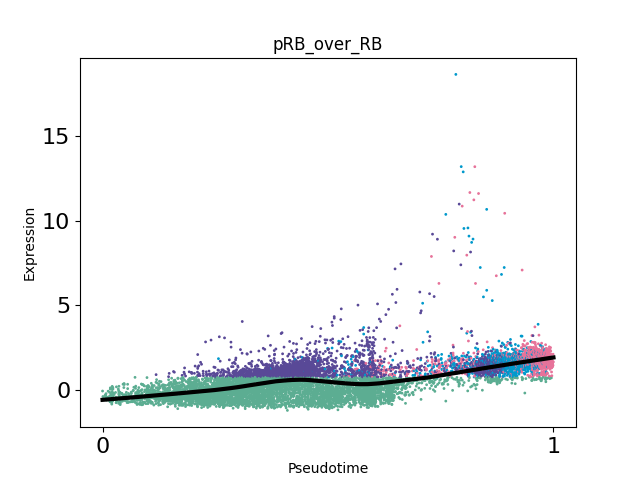

In [32]:
for feature in feature_cols:
    fig = plt.figure()
    ax=fig.add_subplot(111)
    sling_colors = x0_sorted_phate['phase_colors']
    ax.scatter(x0_sorted_phate['pseudotime_scaled'], x0_sorted_phate[feature], c=sling_colors, s=1)
    ax.plot(x0_loess_phate['pseudotime_scaled'], x0_loess_phate[feature], label='0 nM', c='black', linewidth='3')
    ax.tick_params(labelsize=16)
    ax.set_xticks([0,1])

    ax.set_title(feature)
    ax.set_xlabel('Pseudotime')
    ax.set_ylabel('Expression')

    plt.show()

    plt.savefig(f"figures/feature_ti/phate_{feature}.pdf", format="pdf", bbox_inches="tight")

### SPCA Trends

In [ ]:
x1_loess_spca = pd.DataFrame()
x1_loess_spca['pseudotime_scaled'] = x1_sorted_spca['pseudotime_scaled']

x10_loess_spca = pd.DataFrame()
x10_loess_spca['pseudotime_scaled'] = x10_sorted_spca['pseudotime_scaled']

x100_loess_spca = pd.DataFrame()
x100_loess_spca['pseudotime_scaled'] = x100_sorted_spca['pseudotime_scaled']

x1000_loess_spca = pd.DataFrame()
x1000_loess_spca['pseudotime_scaled'] = x1000_sorted_spca['pseudotime_scaled']

In [ ]:
xx = x1_loess_spca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x1_sorted_spca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x1_loess_spca[feature_cols[i]] = yout

In [ ]:
xx = x10_loess_spca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x10_sorted_spca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x10_loess_spca[feature_cols[i]] = yout

In [ ]:
xx = x100_loess_spca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x100_sorted_spca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x100_loess_spca[feature_cols[i]] = yout

In [ ]:
xx = x1000_loess_spca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x1000_sorted_spca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x1000_loess_spca[feature_cols[i]] = yout

In [ ]:
# x1_loess_spca.to_csv("data/spca_loess_1.csv", index = False)
# x10_loess_spca.to_csv("data/spca_loess_10.csv", index = False)
# x100_loess_spca.to_csv("data/spca_loess_100.csv", index = False)
# x1000_loess_spca.to_csv("data/spca_loess_1000.csv", index = False)

In [33]:
# run if trend data has been calculated and written to a csv from running above 
x1_loess_spca = pd.read_csv("data/spca_loess_1.csv")
x10_loess_spca = pd.read_csv("data/spca_loess_10.csv")
x100_loess_spca = pd.read_csv("data/spca_loess_100.csv")
x1000_loess_spca = pd.read_csv("data/spca_loess_1000.csv")

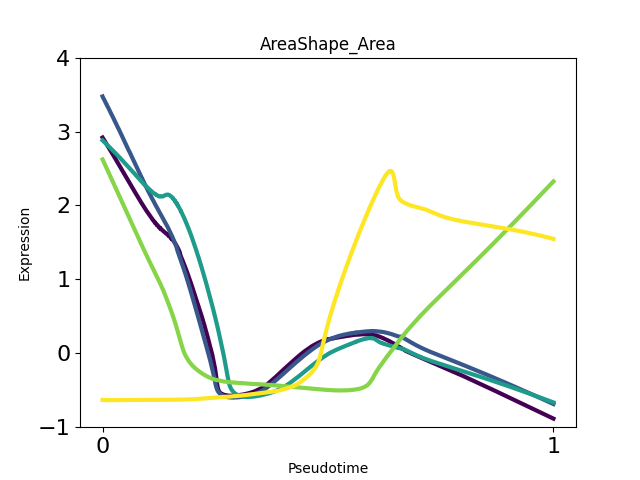

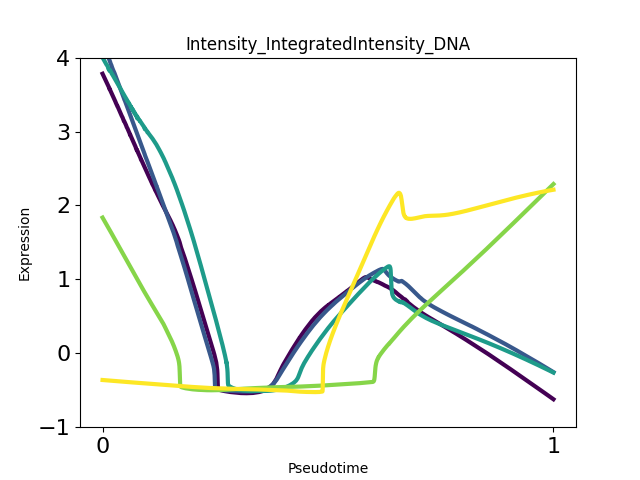

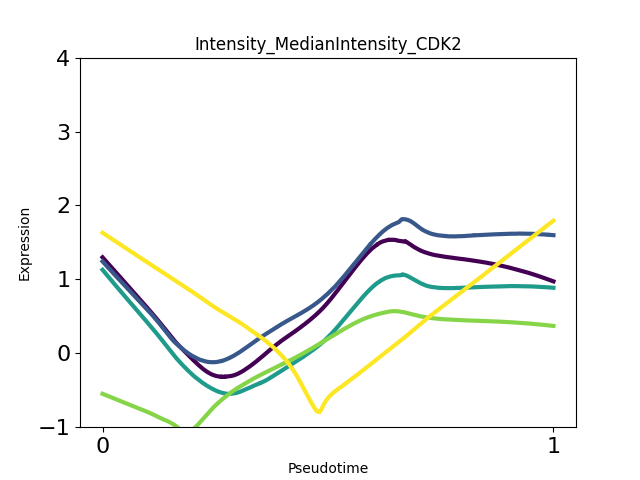

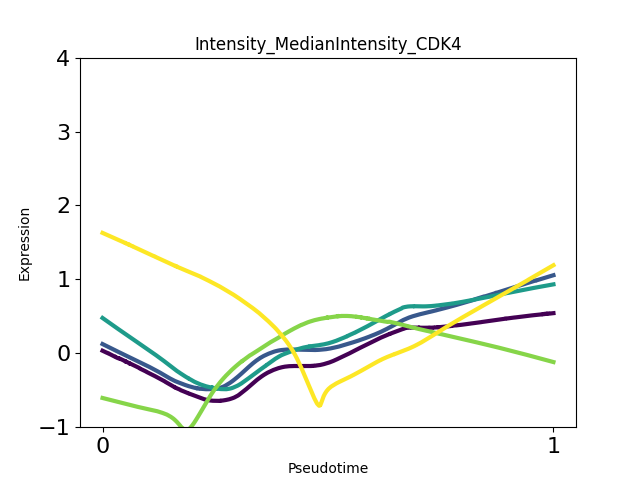

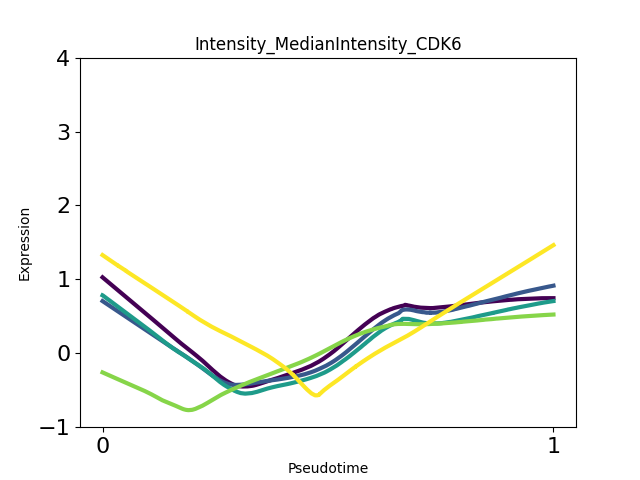

...

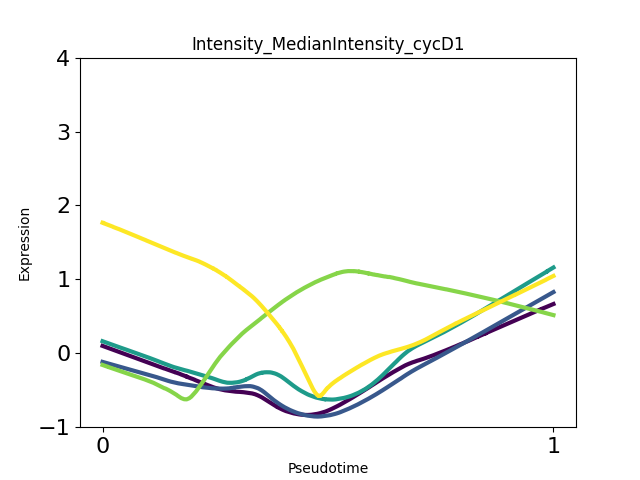

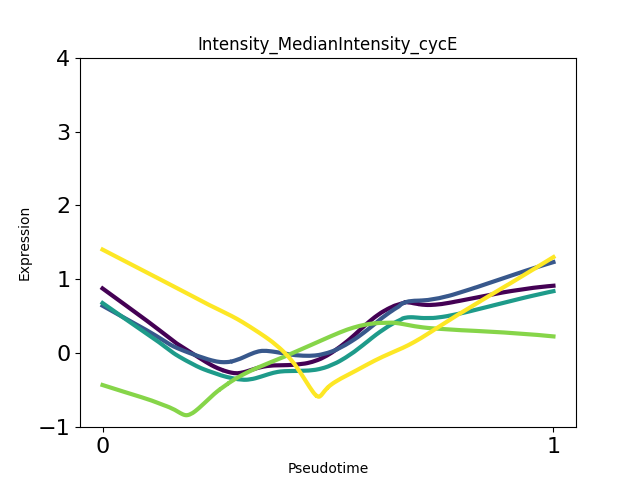

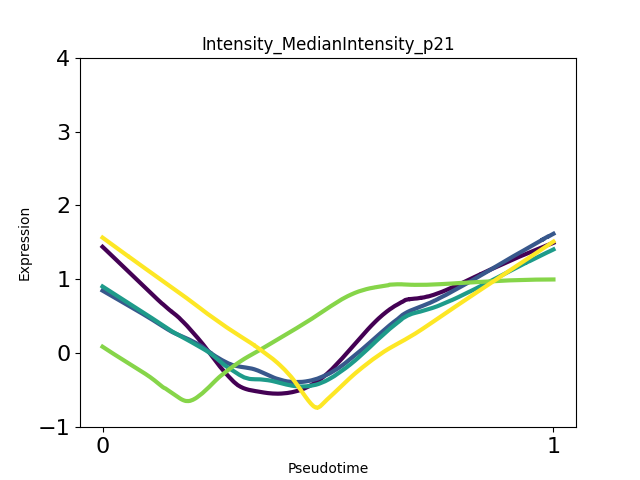

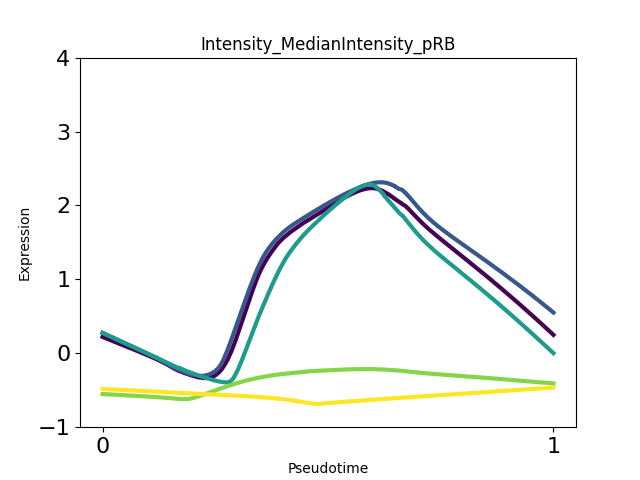

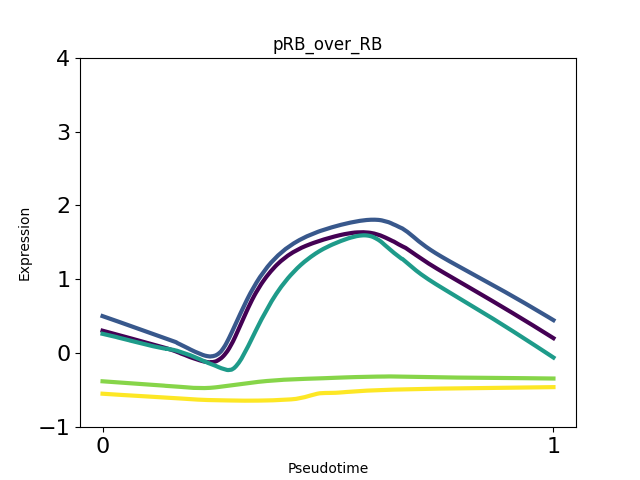

In [34]:
for i in range(len(feature_cols)):
    fig = plt.figure()
    ax=fig.add_subplot(111)
    for j in range(1, len(trt_conditions)):
        ax.plot(vars()[f'x{trt_conditions[j]}_loess_spca']['pseudotime_scaled'], vars()[f'x{trt_conditions[j]}_loess_spca'][feature_cols[i]], label=f'{trt_conditions[j]} nM', linewidth=3, c=trt_colors[j-1])
        ax.tick_params(labelsize=16)
        ax.set_xticks([0,1])
        ax.set_ylim(-1, 4)
        ax.set_title(f"{feature_cols[i]}")
        ax.set_ylabel('Expression')
        ax.set_xlabel('Pseudotime')
        plt.savefig(f"figures/feature_ti/{feature_cols[i]}_trends.pdf", format="pdf", bbox_inches="tight")


## PCA Trends 

In [ ]:
x1_loess_pca = pd.DataFrame()
x1_loess_pca['pseudotime_scaled'] = x1_sorted_pca['pseudotime_scaled']

x10_loess_pca = pd.DataFrame()
x10_loess_pca['pseudotime_scaled'] = x10_sorted_pca['pseudotime_scaled']

x100_loess_pca = pd.DataFrame()
x100_loess_pca['pseudotime_scaled'] = x100_sorted_pca['pseudotime_scaled']

x1000_loess_pca = pd.DataFrame()
x1000_loess_pca['pseudotime_scaled'] = x1000_sorted_pca['pseudotime_scaled']

In [ ]:
xx = x1_loess_pca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x1_sorted_pca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x1_loess_pca[feature_cols[i]] = yout

In [ ]:
xx = x10_loess_pca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x10_sorted_pca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x10_loess_pca[feature_cols[i]] = yout

In [ ]:
xx = x100_loess_pca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x100_sorted_pca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x100_loess_pca[feature_cols[i]] = yout

In [ ]:
xx = x1000_loess_pca['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x1000_sorted_pca[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x1000_loess_pca[feature_cols[i]] = yout

In [ ]:
x1_loess_pca.to_csv("data/pca_loess_1.csv", index = False)
x10_loess_pca.to_csv("data/pca_loess_10.csv", index = False)
x100_loess_pca.to_csv("data/pca_loess_100.csv", index = False)
x1000_loess_pca.to_csv("data/pca_loess_1000.csv", index = False)

In [35]:
# run if trend data has been calculated and written to a csv from running above 
x1_loess_pca = pd.read_csv("data/pca_loess_1.csv")
x10_loess_pca = pd.read_csv("data/pca_loess_10.csv")
x100_loess_pca = pd.read_csv("data/pca_loess_100.csv")
x1000_loess_pca = pd.read_csv("data/pca_loess_1000.csv")

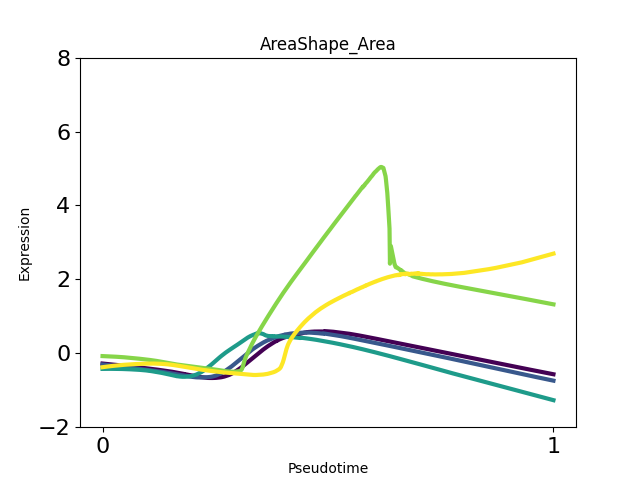

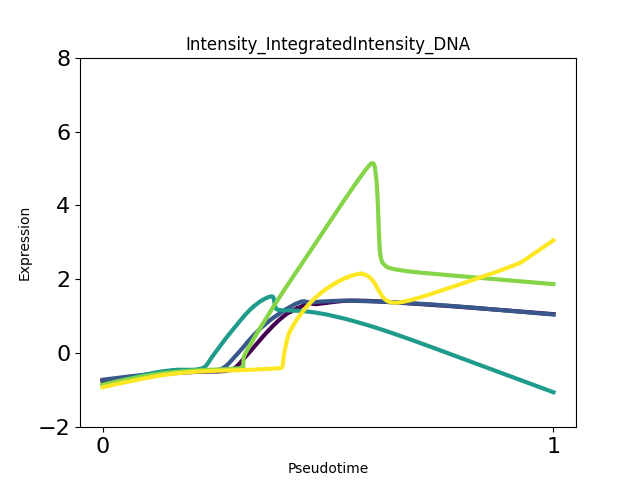

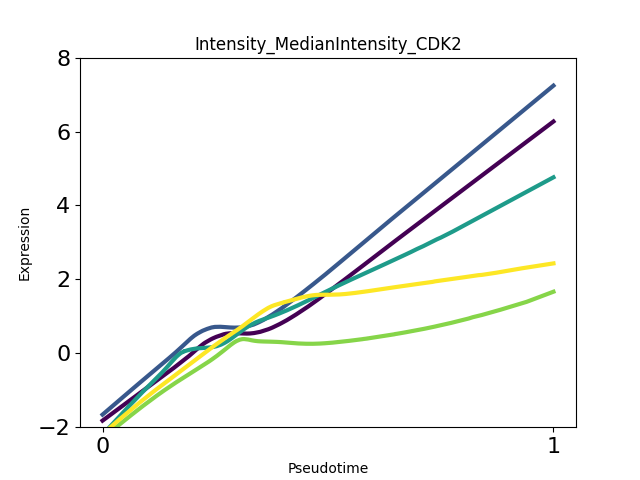

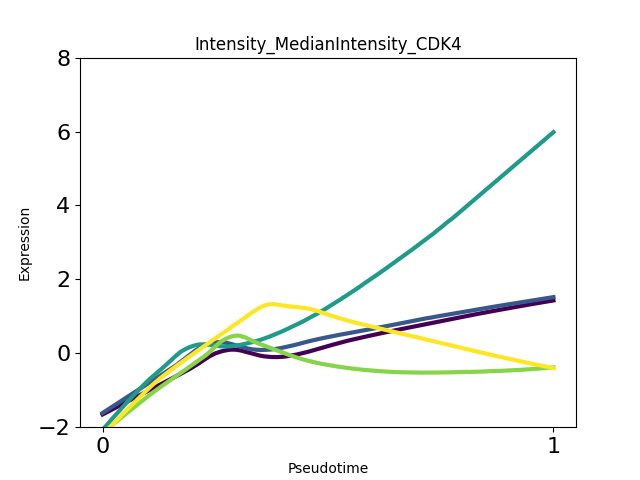

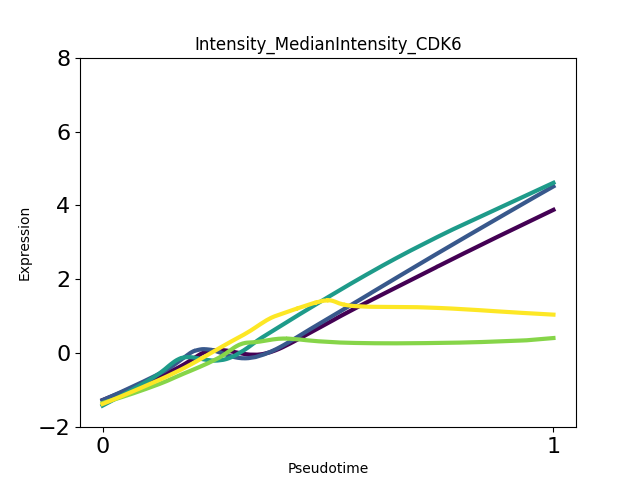

...

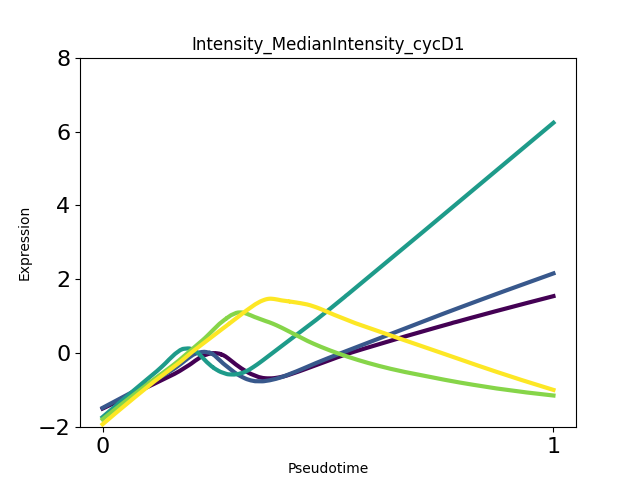

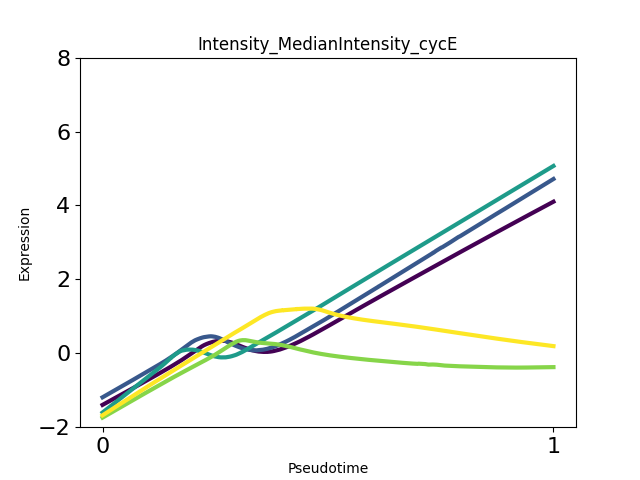

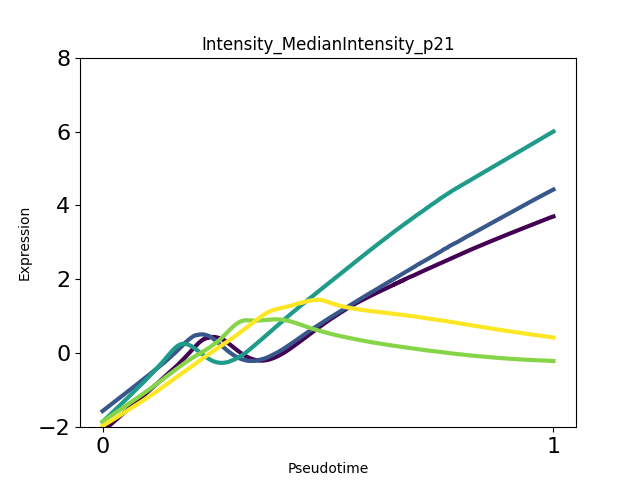

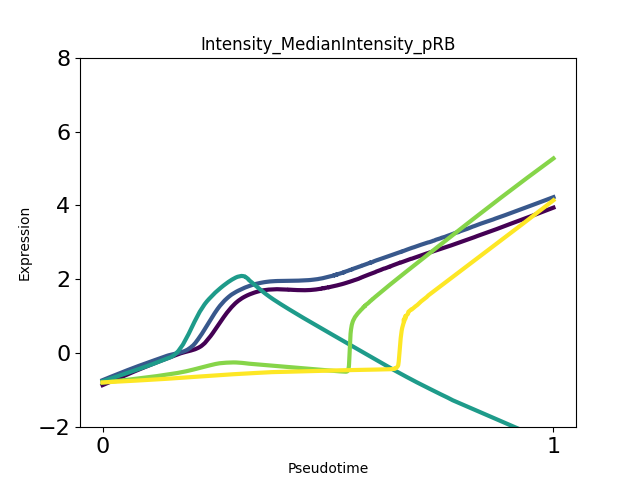

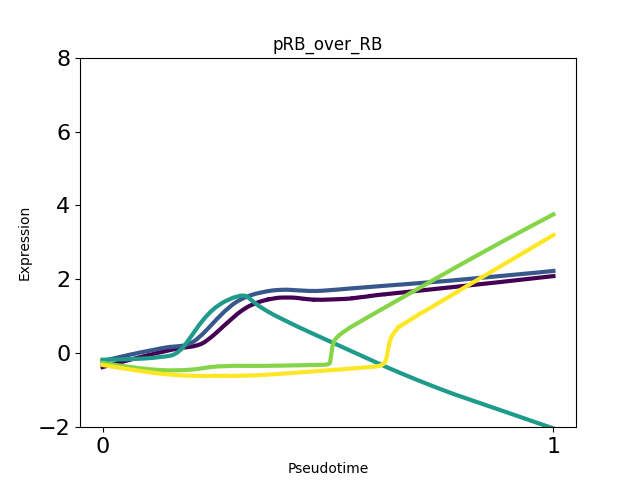

In [36]:
for i in range(len(feature_cols)):
    fig = plt.figure()
    ax=fig.add_subplot(111)
    for j in range(1, len(trt_conditions)):
        ax.plot(vars()[f'x{trt_conditions[j]}_loess_pca']['pseudotime_scaled'], vars()[f'x{trt_conditions[j]}_loess_pca'][feature_cols[i]], label=f'{trt_conditions[j]} nM', linewidth=3, c=trt_colors[j-1])
        ax.tick_params(labelsize=16)
        ax.set_xticks([0,1])
        ax.set_ylim(-2, 8)
        ax.set_title(f"{feature_cols[i]}")
        ax.set_ylabel('Expression')
        ax.set_xlabel('Pseudotime')
        plt.savefig(f"figures/feature_ti/pca_{feature_cols[i]}_trends.pdf", format="pdf", bbox_inches="tight")


## PHATE Trends 

In [ ]:
x1_loess_phate = pd.DataFrame()
x1_loess_phate['pseudotime_scaled'] = x1_sorted_phate['pseudotime_scaled']

x10_loess_phate = pd.DataFrame()
x10_loess_phate['pseudotime_scaled'] = x10_sorted_phate['pseudotime_scaled']

x100_loess_phate = pd.DataFrame()
x100_loess_phate['pseudotime_scaled'] = x100_sorted_phate['pseudotime_scaled']

x1000_loess_phate = pd.DataFrame()
x1000_loess_phate['pseudotime_scaled'] = x1000_sorted_phate['pseudotime_scaled']

In [ ]:
xx = x1_loess_phate['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x1_sorted_phate[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x1_loess_phate[feature_cols[i]] = yout

In [ ]:
xx = x10_loess_phate['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x10_sorted_phate[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x10_loess_phate[feature_cols[i]] = yout

In [ ]:
xx = x100_loess_phate['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x100_sorted_phate[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x100_loess_phate[feature_cols[i]] = yout

In [ ]:
xx = x1000_loess_phate['pseudotime_scaled']
for i in range(len(feature_cols)):
    yy = x1000_sorted_phate[feature_cols[i]]
    xout, yout, wout = loess_1d.loess_1d(xx.to_numpy(), yy.to_numpy())
    x1000_loess_phate[feature_cols[i]] = yout

In [ ]:
# x1_loess_phate.to_csv("data/phate_loess_1.csv", index = False)
# x10_loess_phate.to_csv("data/phate_loess_10.csv", index = False)
# x100_loess_phate.to_csv("data/phate_loess_100.csv", index = False)
# x1000_loess_phate.to_csv("data/phate_loess_1000.csv", index = False)

In [37]:
# run if trend data has been calculated and written to a csv from running above 
x1_loess_phate = pd.read_csv("data/phate_loess_1.csv")
x10_loess_phate = pd.read_csv("data/phate_loess_10.csv")
x100_loess_phate = pd.read_csv("data/phate_loess_100.csv")
x1000_loess_phate = pd.read_csv("data/phate_loess_1000.csv")

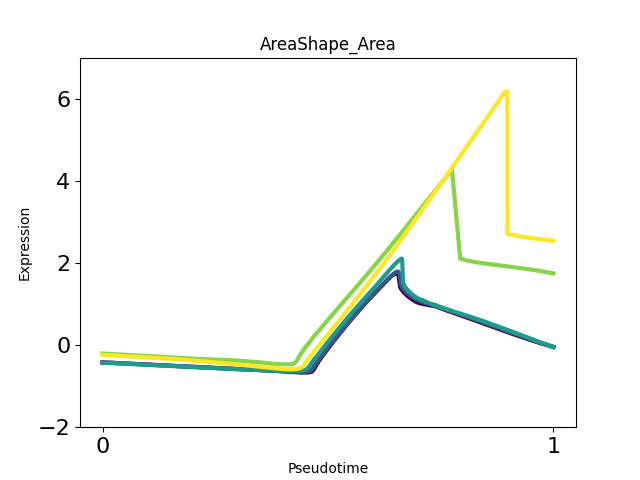

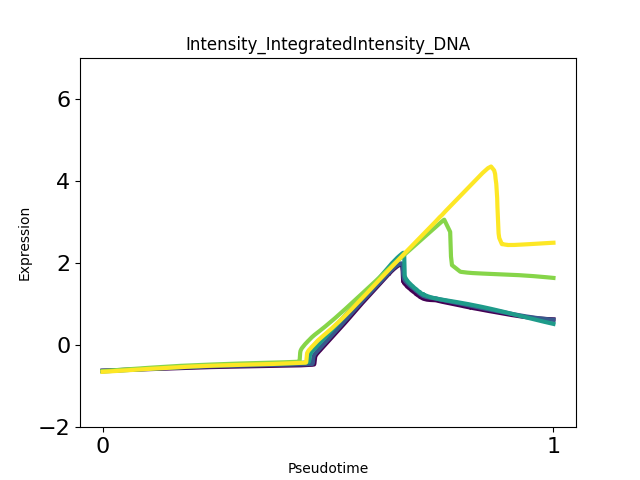

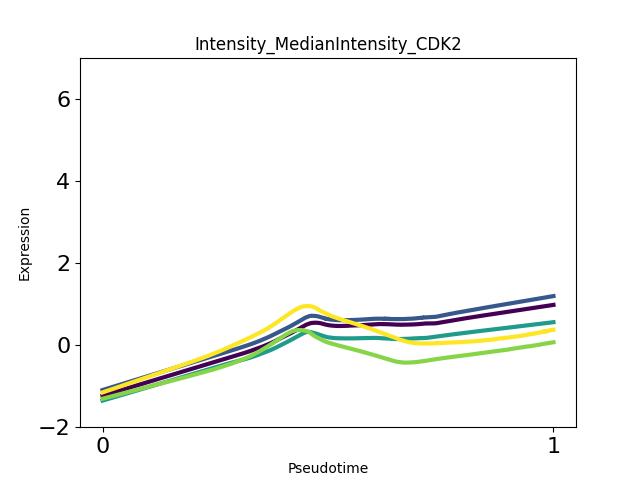

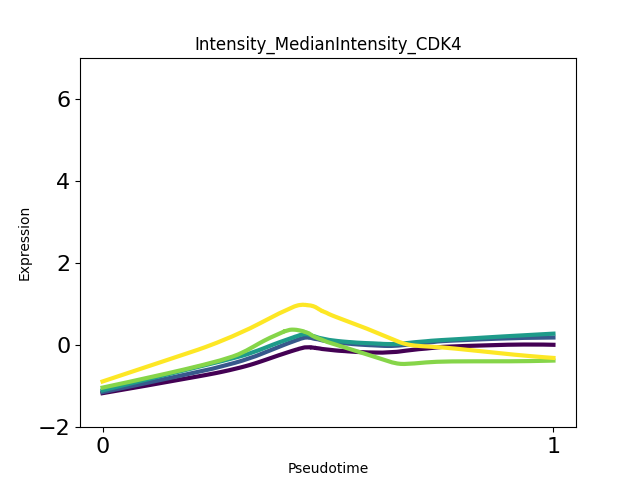

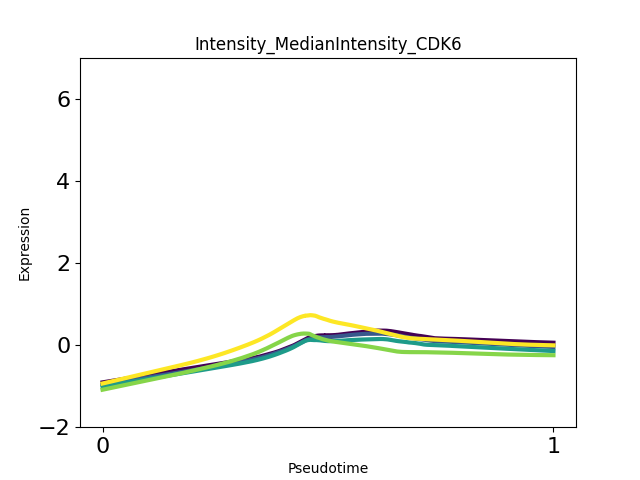

...

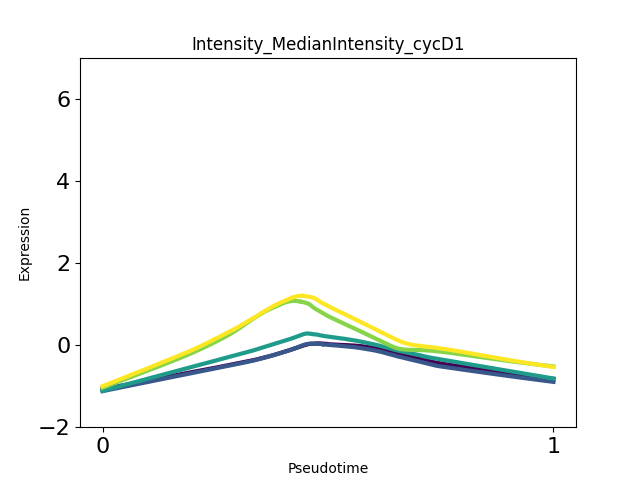

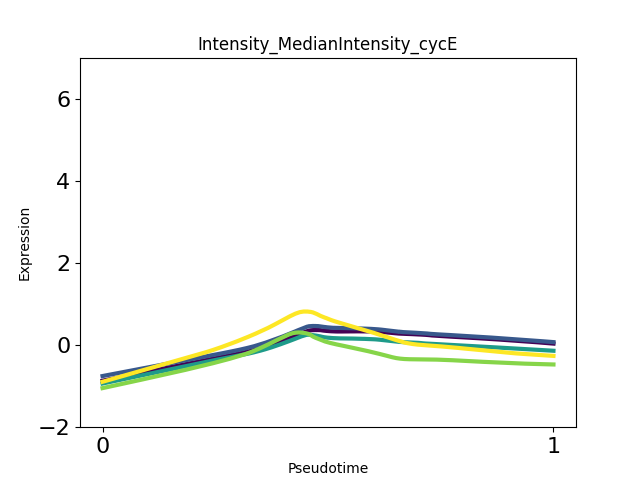

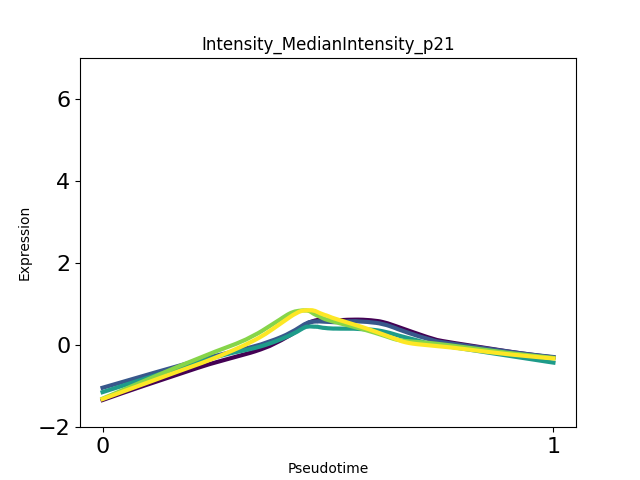

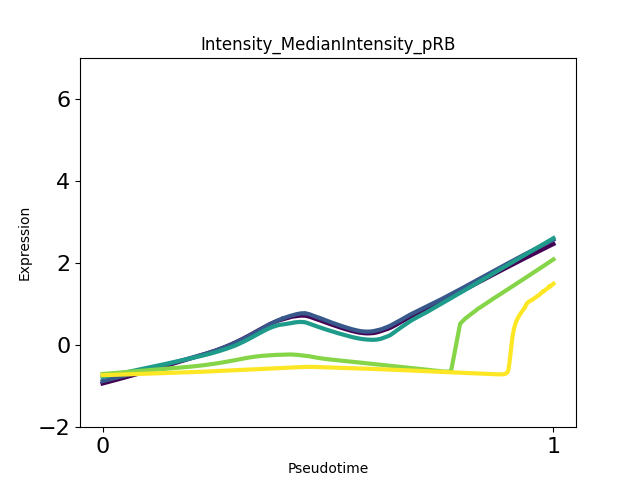

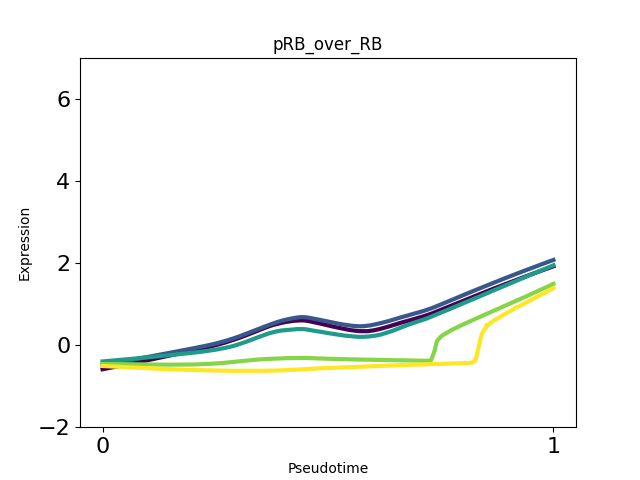

In [38]:
for i in range(len(feature_cols)):
    fig = plt.figure()
    ax=fig.add_subplot(111)
    for j in range(1, len(trt_conditions)):
        ax.plot(vars()[f'x{trt_conditions[j]}_loess_phate']['pseudotime_scaled'], vars()[f'x{trt_conditions[j]}_loess_phate'][feature_cols[i]], label=f'{trt_conditions[j]} nM', linewidth=3, c=trt_colors[j-1])
        ax.tick_params(labelsize=16)
        ax.set_xticks([0,1])
        ax.set_ylim(-2, 7)
        ax.set_title(f"{feature_cols[i]}")
        ax.set_ylabel('Expression')
        ax.set_xlabel('Pseudotime')
        plt.savefig(f"figures/feature_ti/phate_{feature_cols[i]}_trends.pdf", format="pdf", bbox_inches="tight")


## Early vs. Late G0 Cells

In [39]:
med_pseudo_0 = statistics.median(x0_sorted_spca['pseudotime_scaled'])
med_pseudo_1 = statistics.median(x1_sorted_spca['pseudotime_scaled'])
med_pseudo_10 = statistics.median(x10_sorted_spca['pseudotime_scaled'])
med_pseudo_100 = statistics.median(x100_sorted_spca['pseudotime_scaled'])
med_pseudo_1000 = statistics.median(x1000_sorted_spca['pseudotime_scaled'])

In [40]:
early_g0_0 = x0_sorted_spca[x0_sorted_spca['pseudotime_scaled'] <= med_pseudo_0]
early_g0_0 = early_g0_0[early_g0_0['phase'] == "G0"]
early_g0_1 = x1_sorted_spca[x1_sorted_spca['pseudotime_scaled'] <= med_pseudo_1]
early_g0_1 = early_g0_1[early_g0_1['phase'] == "G0"]
early_g0_10 = x10_sorted_spca[x10_sorted_spca['pseudotime_scaled'] <= med_pseudo_10]
early_g0_10 = early_g0_10[early_g0_10['phase'] == "G0"]
early_g0_100 = x100_sorted_spca[x100_sorted_spca['pseudotime_scaled'] <= med_pseudo_100]
early_g0_100 = early_g0_100[early_g0_100['phase'] == "G0"]
early_g0_1000 = x1000_sorted_spca[x1000_sorted_spca['pseudotime_scaled'] <= med_pseudo_1000]
early_g0_1000 = early_g0_1000[early_g0_1000['phase'] == "G0"]

late_g0_0 = x0_sorted_spca[x0_sorted_spca['pseudotime_scaled'] > med_pseudo_0]
late_g0_0 = late_g0_0[late_g0_0['phase'] == "G0"]
late_g0_1 = x1_sorted_spca[x1_sorted_spca['pseudotime_scaled'] > med_pseudo_1]
late_g0_1 = late_g0_1[late_g0_1['phase'] == "G0"]
late_g0_10 = x10_sorted_spca[x10_sorted_spca['pseudotime_scaled'] > med_pseudo_10]
late_g0_10 = late_g0_10[late_g0_10['phase'] == "G0"]
late_g0_100 = x100_sorted_spca[x100_sorted_spca['pseudotime_scaled'] > med_pseudo_100]
late_g0_100 = late_g0_100[late_g0_100['phase'] == "G0"]
late_g0_1000 = x1000_sorted_spca[x1000_sorted_spca['pseudotime_scaled'] > med_pseudo_1000]
late_g0_1000 = late_g0_1000[late_g0_1000['phase'] == "G0"]

In [41]:
# early g0 values 
for i in range(len(features)): 
    vars()[f'{features[i]}_early'] = [
        round(early_g0_0[feature_cols[i]].mean(), 2), 
        round(early_g0_1[feature_cols[i]].mean(), 2), 
        round(early_g0_10[feature_cols[i]].mean(), 2), 
        round(early_g0_100[feature_cols[i]].mean(), 2), 
        round(early_g0_1000[feature_cols[i]].mean(), 2)
        ]

In [42]:
# late g0 values 
for i in range(len(features)): 
    vars()[f'{features[i]}_late'] = [
        round(late_g0_0[feature_cols[i]].mean(), 2), 
        round(late_g0_1[feature_cols[i]].mean(), 2), 
        round(late_g0_10[feature_cols[i]].mean(), 2), 
        round(late_g0_100[feature_cols[i]].mean(), 2), 
        round(late_g0_1000[feature_cols[i]].mean(), 2)
        ]

In [43]:
reordered_features = [
    'Ki67',
    'pRB',
    'Skp2',
    'pRB_over_RB',
    'cycA', 
    'cycB1',
    'RB',
    'CDK2',
    'PR',
    'Cdt1',
    'Cdh1',
    'E2F1',
    'ER',
    'CDK6',
    'p21',
    'cycE',
    'DNA',
    'CDK4',
    'Area', 
    'cycD1',
]

In [44]:
reordered_early = pd.DataFrame(list(zip(trt_conditions[1:], Ki67_early, pRB_early, Skp2_early, pRB_over_RB_early, cycA_early, cycB1_early, RB_early, CDK2_early, PR_early, Cdt1_early, Cdh1_early, E2F1_early, ER_early, CDK6_early, p21_early, cycE_early, DNA_early, CDK4_early, Area_early, cycD1_early)), columns=['Treatment'] + reordered_features)
reordered_early_arr = reordered_early.drop(['Treatment'],axis=1).to_numpy()

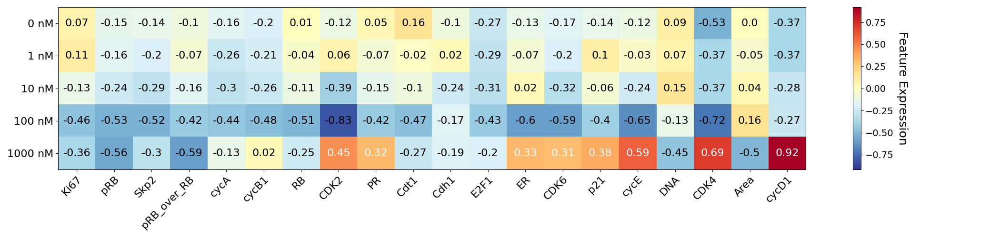

In [66]:
fig, ax = plt.subplots(figsize=(21,5))
im = ax.imshow(reordered_early_arr, aspect='auto', cmap="RdYlBu_r", norm=colors.CenteredNorm())

ax.set_xticks(np.arange(len(reordered_features)), labels=reordered_features, fontsize="16")
ax.set_yticks(np.arange(len(trt_conditions[1:])), labels=[f'{trt_conditions[i]} nM' for i in range(1,len(trt_conditions))], fontsize="16")

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(trt_conditions)-1):
    for j in range(len(reordered_features)):
        if reordered_early_arr[i, j] > 0.25 or reordered_early_arr[i, j] < -0.95: 
            text = ax.text(j, i, reordered_early_arr[i, j],
                        ha="center", va="center", color="w", fontsize="16")
        else: 
            text = ax.text(j, i, reordered_early_arr[i, j],
                        ha="center", va="center", color="black", fontsize="16")
        
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.set_ylabel('Feature Expression', rotation=-90, va="bottom", fontsize="18")

fig.tight_layout()

plt.show()

# plt.savefig(f"figures/g0_ti/early_g0_all.pdf", format="pdf", bbox_inches="tight")

In [46]:
for i in range(len(trt_conditions)-1): 
    vars()[f'early_{trt_conditions[i+1]}_all'] = [
        Ki67_early[i], 
        pRB_early[i], 
        Skp2_early[i], 
        pRB_over_RB_early[i], 
        cycA_early[i], 
        cycB1_early[i], 
        RB_early[i], 
        CDK2_early[i], 
        PR_early[i], 
        Cdt1_early[i], 
        Cdh1_early[i], 
        E2F1_early[i], 
        ER_early[i], 
        CDK6_early[i], 
        p21_early[i], 
        cycE_early[i], 
        DNA_early[i], 
        CDK4_early[i], 
        Area_early[i], 
        cycD1_early[i]
    ]

In [47]:
for i in range(len(trt_conditions)-1): 
    vars()[f'late_{trt_conditions[i+1]}_all'] = [
        Ki67_late[i], 
        pRB_late[i], 
        Skp2_late[i], 
        pRB_over_RB_late[i], 
        cycA_late[i], 
        cycB1_late[i], 
        RB_late[i], 
        CDK2_late[i], 
        PR_late[i], 
        Cdt1_late[i], 
        Cdh1_late[i], 
        E2F1_late[i], 
        ER_late[i], 
        CDK6_late[i], 
        p21_late[i], 
        cycE_late[i], 
        DNA_late[i], 
        CDK4_late[i], 
        Area_late[i], 
        cycD1_late[i]
    ]

In [48]:
reordered_early_late = pd.DataFrame(list(zip(reordered_features, early_0_all, early_1_all, early_10_all, early_100_all, early_1000_all, late_0_all, late_1_all, late_10_all, late_100_all, late_1000_all)), columns=['Feature'] + trt_conditions[1:] + trt_conditions[1:])
reordered_early_late_arr = reordered_early_late.drop(['Feature'],axis=1).to_numpy()

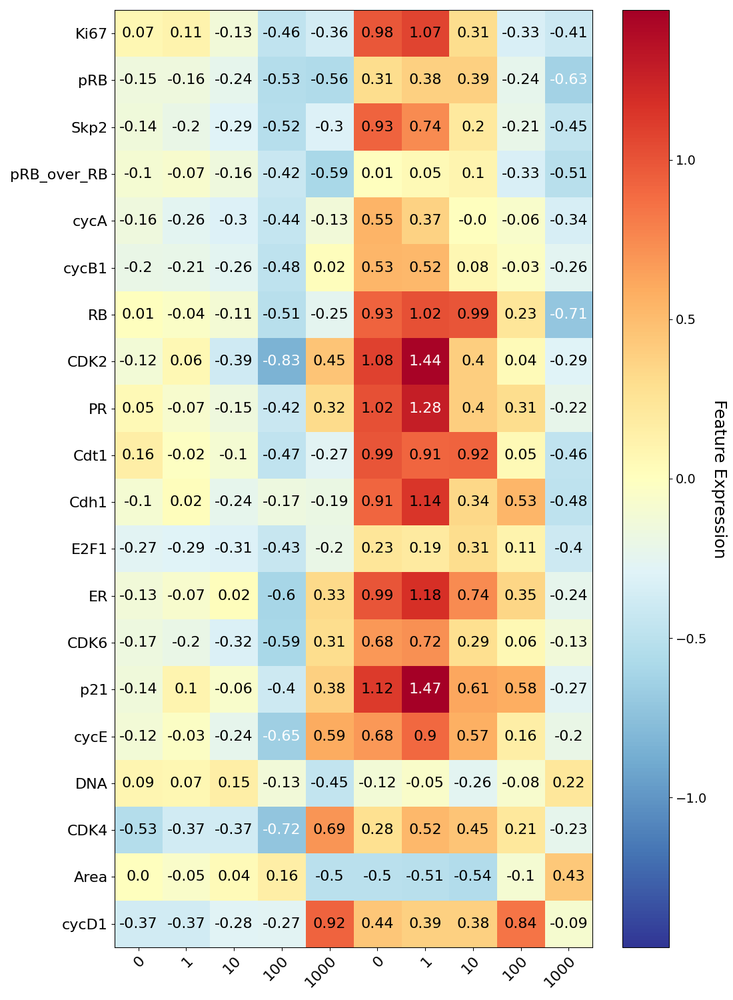

In [67]:
fig, ax = plt.subplots(figsize=(11,15))
im = ax.imshow(reordered_early_late_arr, aspect='auto', cmap="RdYlBu_r", norm=colors.CenteredNorm())

ax.set_xticks(np.arange(10), labels=trt_conditions[1:]+trt_conditions[1:], fontsize="16")
ax.set_yticks(np.arange(len(reordered_features)), labels=reordered_features, fontsize="16")

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(reordered_features)):
    for j in range(10):
        if reordered_early_late_arr[i, j] > 1.25 or reordered_early_late_arr[i, j] < -0.6: 
            text = ax.text(j, i, reordered_early_late_arr[i, j],
                        ha="center", va="center", color="w", fontsize="16")
        else: 
            text = ax.text(j, i, reordered_early_late_arr[i, j],
                        ha="center", va="center", color="black", fontsize="16")
        
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.set_ylabel('Feature Expression', rotation=-90, va="bottom", fontsize="18")

fig.tight_layout()

plt.show()

plt.savefig(f"figures/g0_ti/early_late_g0_all.pdf", format="pdf", bbox_inches="tight")

### Early vs. Late G1 Cells

In [54]:
early_g1_0 = x0_sorted_spca[x0_sorted_spca['pseudotime_scaled'] <= med_pseudo_0]
early_g1_0 = early_g1_0[early_g1_0['phase'] == "G1"]
early_g1_1 = x1_sorted_spca[x1_sorted_spca['pseudotime_scaled'] <= med_pseudo_1]
early_g1_1 = early_g1_1[early_g1_1['phase'] == "G1"]
early_g1_10 = x10_sorted_spca[x10_sorted_spca['pseudotime_scaled'] <= med_pseudo_10]
early_g1_10 = early_g1_10[early_g1_10['phase'] == "G1"]
early_g1_100 = x100_sorted_spca[x100_sorted_spca['pseudotime_scaled'] <= med_pseudo_100]
early_g1_100 = early_g1_100[early_g1_100['phase'] == "G1"]
early_g1_1000 = x1000_sorted_spca[x1000_sorted_spca['pseudotime_scaled'] <= med_pseudo_1000]
early_g1_1000 = early_g1_1000[early_g1_1000['phase'] == "G1"]

late_g1_0 = x0_sorted_spca[x0_sorted_spca['pseudotime_scaled'] > med_pseudo_0]
late_g1_0 = late_g1_0[late_g1_0['phase'] == "G1"]
late_g1_1 = x1_sorted_spca[x1_sorted_spca['pseudotime_scaled'] > med_pseudo_1]
late_g1_1 = late_g1_1[late_g1_1['phase'] == "G1"]
late_g1_10 = x10_sorted_spca[x10_sorted_spca['pseudotime_scaled'] > med_pseudo_10]
late_g1_10 = late_g1_10[late_g1_10['phase'] == "G1"]
late_g1_100 = x100_sorted_spca[x100_sorted_spca['pseudotime_scaled'] > med_pseudo_100]
late_g1_100 = late_g1_100[late_g1_100['phase'] == "G1"]
late_g1_1000 = x1000_sorted_spca[x1000_sorted_spca['pseudotime_scaled'] > med_pseudo_1000]
late_g1_1000 = late_g1_1000[late_g1_1000['phase'] == "G1"]

In [55]:
# early g1 values 
for i in range(len(features)): 
    vars()[f'{features[i]}_early_g1'] = [
        round(early_g1_0[feature_cols[i]].mean(), 2), 
        round(early_g1_1[feature_cols[i]].mean(), 2), 
        round(early_g1_10[feature_cols[i]].mean(), 2), 
        round(early_g1_100[feature_cols[i]].mean(), 2), 
        round(early_g1_1000[feature_cols[i]].mean(), 2)
        ]

In [56]:
# late g1 values 
for i in range(len(features)): 
    vars()[f'{features[i]}_late_g1'] = [
        round(late_g1_0[feature_cols[i]].mean(), 2), 
        round(late_g1_1[feature_cols[i]].mean(), 2), 
        round(late_g1_10[feature_cols[i]].mean(), 2), 
        round(late_g1_100[feature_cols[i]].mean(), 2), 
        round(late_g1_1000[feature_cols[i]].mean(), 2)
        ]

In [57]:
for i in range(len(trt_conditions)-1): 
    vars()[f'early_{trt_conditions[i+1]}_all_g1'] = [
        Ki67_early_g1[i], 
        pRB_early_g1[i], 
        Skp2_early_g1[i], 
        pRB_over_RB_early_g1[i], 
        cycA_early_g1[i], 
        cycB1_early_g1[i], 
        RB_early_g1[i], 
        CDK2_early_g1[i], 
        PR_early_g1[i], 
        Cdt1_early_g1[i], 
        Cdh1_early_g1[i], 
        E2F1_early_g1[i], 
        ER_early_g1[i], 
        CDK6_early_g1[i], 
        p21_early_g1[i], 
        cycE_early_g1[i], 
        DNA_early_g1[i], 
        CDK4_early_g1[i], 
        Area_early_g1[i], 
        cycD1_early_g1[i]
    ]

In [58]:
for i in range(len(trt_conditions)-1): 
    vars()[f'late_{trt_conditions[i+1]}_all_g1'] = [
        Ki67_late_g1[i], 
        pRB_late_g1[i], 
        Skp2_late_g1[i], 
        pRB_over_RB_late_g1[i], 
        cycA_late_g1[i], 
        cycB1_late_g1[i], 
        RB_late_g1[i], 
        CDK2_late_g1[i], 
        PR_late_g1[i], 
        Cdt1_late_g1[i], 
        Cdh1_late_g1[i], 
        E2F1_late_g1[i], 
        ER_late_g1[i], 
        CDK6_late_g1[i], 
        p21_late_g1[i], 
        cycE_late_g1[i], 
        DNA_late_g1[i], 
        CDK4_late_g1[i], 
        Area_late_g1[i], 
        cycD1_late_g1[i]
    ]

In [59]:
reordered_early_late_g1 = pd.DataFrame(list(zip(reordered_features, early_0_all_g1, early_1_all_g1, early_10_all_g1, early_100_all_g1, early_1000_all_g1, late_0_all_g1, late_1_all_g1, late_10_all_g1, late_100_all_g1, late_1000_all_g1)), columns=['Feature'] + trt_conditions[1:] + trt_conditions[1:])
reordered_early_late_g1_arr = reordered_early_late_g1.drop(['Feature'],axis=1).to_numpy()

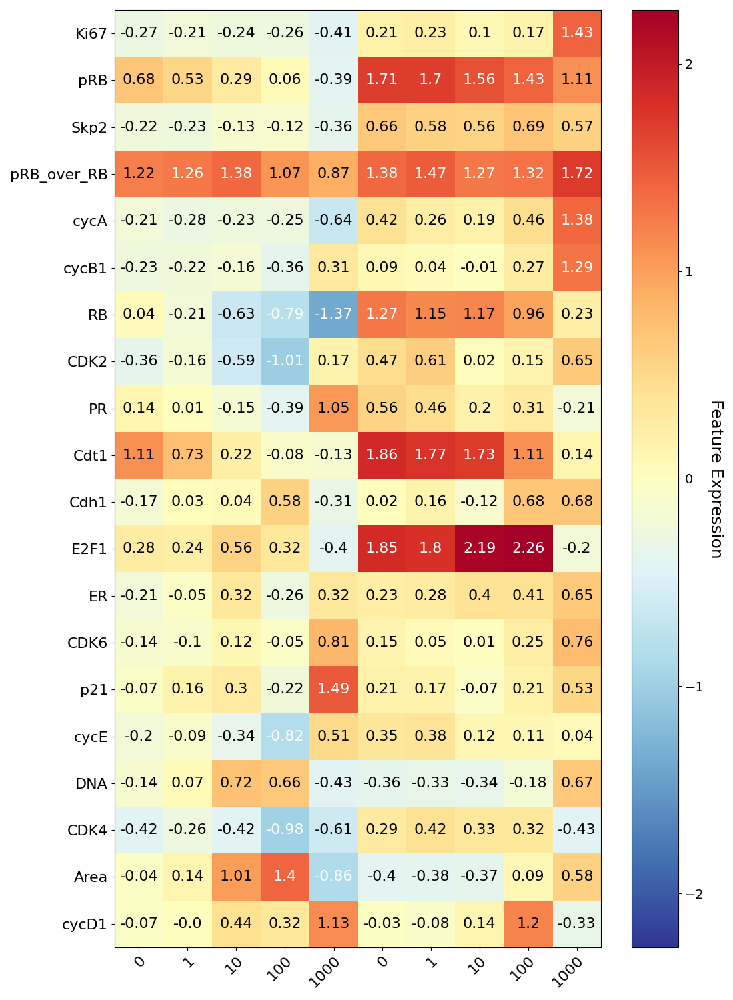

In [68]:
fig, ax = plt.subplots(figsize=(11,15))
im = ax.imshow(reordered_early_late_g1_arr, aspect='auto', cmap="RdYlBu_r", norm=colors.CenteredNorm())

ax.set_xticks(np.arange(10), labels=trt_conditions[1:]+trt_conditions[1:], fontsize="16")
ax.set_yticks(np.arange(len(reordered_features)), labels=reordered_features, fontsize="16")

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(reordered_features)):
    for j in range(10):
        if reordered_early_late_g1_arr[i, j] > 1.25 or reordered_early_late_g1_arr[i, j] < -0.65: 
            text = ax.text(j, i, reordered_early_late_g1_arr[i, j],
                        ha="center", va="center", color="w", fontsize="16")
        else: 
            text = ax.text(j, i, reordered_early_late_g1_arr[i, j],
                        ha="center", va="center", color="black", fontsize="16")
        
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.set_ylabel('Feature Expression', rotation=-90, va="bottom", fontsize="18")

fig.tight_layout()

plt.show()

plt.savefig(f"figures/g0_ti/early_late_g1_all.pdf", format="pdf", bbox_inches="tight")

In [69]:
reordered_g0_g1 = pd.DataFrame(list(zip(reordered_features, late_0_all, late_1_all, late_10_all, late_100_all, late_1000_all, late_0_all_g1, late_1_all_g1, late_10_all_g1, late_100_all_g1, late_1000_all_g1)), columns=['Feature'] + trt_conditions[1:] + trt_conditions[1:])
reordered_g0_g1_arr = reordered_g0_g1.drop(['Feature'],axis=1).to_numpy()

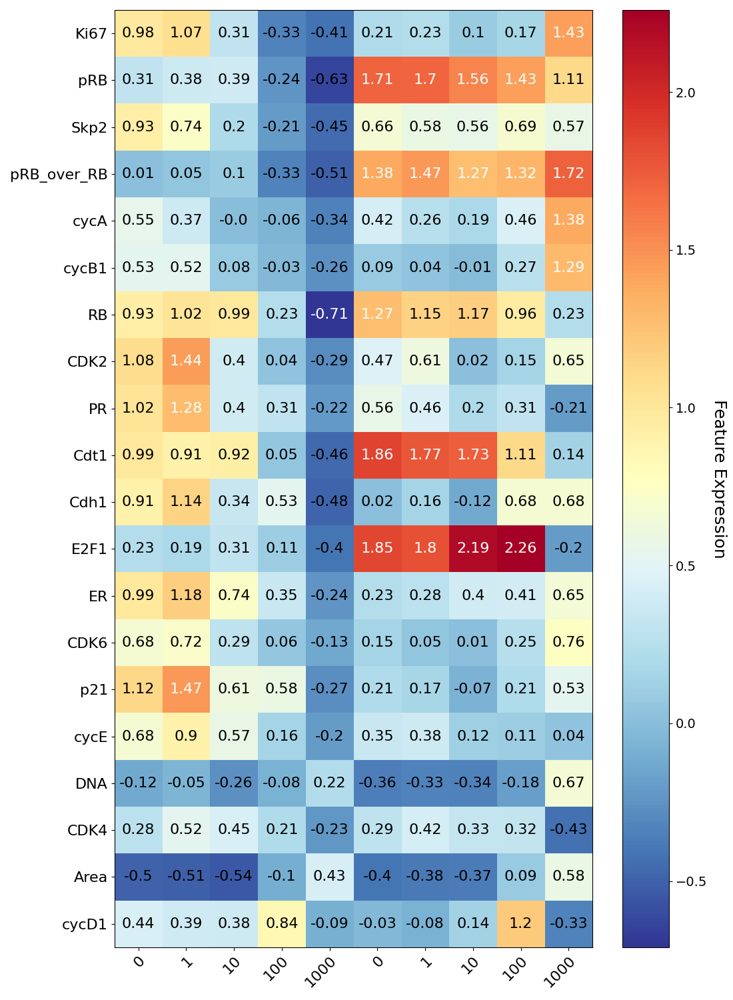

In [70]:
fig, ax = plt.subplots(figsize=(11,15))
im = ax.imshow(reordered_g0_g1_arr, aspect='auto', cmap="RdYlBu_r")

ax.set_xticks(np.arange(10), labels=trt_conditions[1:]+trt_conditions[1:], fontsize="16")
ax.set_yticks(np.arange(len(reordered_features)), labels=reordered_features, fontsize="16")

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(reordered_features)):
    for j in range(10):
        if reordered_g0_g1_arr[i, j] > 1.25 or reordered_g0_g1_arr[i, j] < -0.65: 
            text = ax.text(j, i, reordered_g0_g1_arr[i, j],
                        ha="center", va="center", color="w", fontsize="16")
        else: 
            text = ax.text(j, i, reordered_g0_g1_arr[i, j],
                        ha="center", va="center", color="black", fontsize="16")
        
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.set_ylabel('Feature Expression', rotation=-90, va="bottom", fontsize="18")

fig.tight_layout()

plt.show()

plt.savefig(f"figures/g0_ti/late_g0_g1_all.pdf", format="pdf", bbox_inches="tight")